# Sensitivity Analysis

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import glob
import re
from cycler import cycler

import fiona
import geopandas as gp
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib import collections
import matplotlib.pyplot as plt
from shapely.geometry import LineString, Point, Polygon

%matplotlib inline

sns.color_palette()

sns.set_style("white", {"xtick.direction": "in","ytick.direction": "in"})

### Setup all file scenarios

The files I am going to load are the ones showed in the table below. This is to know which file correspond to what. I have not added the dates in the file name since they are autogenerated and it is a sanity check for me, but in reality the dates (numbers in front of the file name scenario) don't matter.
![scenarios_info.png](scenarios_info_cost.png)
![scenarios_info_cap.png](scenarios_info_capacity.png)

In [2]:
cwd = os.getcwd()

In [3]:
facility_label = ['Manufacturing', 'Recycling', 'Manufacturing_cap', 'Recycling_cap']
location_label = ['NAICS', '40209']
factor_label_rec = ['05', '1', '2', '5', '10']
factor_label_man = ['0001','05', '1', '2'] # 0 is 0,5

In [4]:
files_list = []
for fac in facility_label:
    for loc in location_label:
        if fac.startswith('Manufacturing'):
            for fac_man in factor_label_man:
                files_list.append(fac+'_'+loc+'_'+fac_man)
        else:
            for fac_rec in factor_label_rec:
                files_list.append(fac+'_'+loc+'_'+fac_rec) 

#### Group the files into smaller bins for easier handling

In [5]:
recycling_files = [x for x in files_list if x.startswith('Recycling')]
recycling_files_cap = [x for x in recycling_files if "cap" in x]
recycling_files_cost = [x for x in recycling_files if "cap" not in x]

In [6]:
manufacturing_files = [x for x in files_list if x.startswith('Manufacturing')]
manufacturing_files_cap = [x for x in manufacturing_files if "cap" in x]
manufacturing_files_cost = [x for x in manufacturing_files if "cap" not in x]

#### Dictionary to change year number to actual years

In [7]:
year_list = list(range(2025, 2051, 1))
number_year = list(range(1, 27, 1))
years_dict = dict(zip(number_year,year_list))


#### Load plant files

##### Recycling cost

In [8]:
for files in recycling_files_cost:
    testfile_path = glob.glob(os.path.join(cwd, "scenarios_before_update", files, 'plants.csv'))[0]
    globals()['%s_plants' % (files)] = pd.read_csv(testfile_path) 
    globals()['%s_plants' % (files)] = globals()['%s_plants' % (files)].replace({"year": years_dict})
    print('{}: {} locations'.format(files, len(globals()['%s_plants' % (files)]['location name'].unique())))

Recycling_NAICS_05: 81 locations
Recycling_NAICS_1: 81 locations
Recycling_NAICS_2: 81 locations
Recycling_NAICS_5: 81 locations
Recycling_NAICS_10: 81 locations
Recycling_40209_05: 81 locations
Recycling_40209_1: 81 locations
Recycling_40209_2: 81 locations
Recycling_40209_5: 81 locations
Recycling_40209_10: 81 locations


Some of the manufacturing files have no solution, so we remove them:

##### Manufacturing cost

In [9]:
for files in manufacturing_files_cost:
    testfile_path = glob.glob(os.path.join(cwd, "scenarios_before_update", files, 'plants.csv'))[0]
    globals()['%s_plants' % (files)] = pd.read_csv(testfile_path) 
    globals()['%s_plants' % (files)] = globals()['%s_plants' % (files)].replace({"year": years_dict})
    print('{}: {} locations'.format(files, len(globals()['%s_plants' % (files)]['location name'].unique())))

Manufacturing_NAICS_0001: 188 locations
Manufacturing_NAICS_05: 42 locations
Manufacturing_NAICS_1: 166 locations
Manufacturing_NAICS_2: 166 locations
Manufacturing_40209_0001: 171 locations
Manufacturing_40209_05: 166 locations
Manufacturing_40209_1: 166 locations
Manufacturing_40209_2: 166 locations


##### Recycling capacity

In [10]:
for files in recycling_files_cap:
    testfile_path = glob.glob(os.path.join(cwd, "scenarios_before_update", files, 'plants.csv'))[0]
    globals()['%s_plants' % (files)] = pd.read_csv(testfile_path)
    globals()['%s_plants' % (files)] = globals()['%s_plants' % (files)].replace({"year": years_dict})
    print('{}: {} locations'.format(files, len(globals()['%s_plants' % (files)]['location name'].unique())))    

Recycling_cap_NAICS_05: 161 locations
Recycling_cap_NAICS_1: 81 locations
Recycling_cap_NAICS_2: 41 locations
Recycling_cap_NAICS_5: 17 locations
Recycling_cap_NAICS_10: 10 locations
Recycling_cap_40209_05: 161 locations
Recycling_cap_40209_1: 81 locations
Recycling_cap_40209_2: 41 locations
Recycling_cap_40209_5: 17 locations
Recycling_cap_40209_10: 9 locations


##### Manufacturing capacity

In [11]:
manufacturing_files_cap.remove('Manufacturing_cap_NAICS_0001')
manufacturing_files_cap.remove('Manufacturing_cap_NAICS_05') 
manufacturing_files_cap.remove('Manufacturing_cap_40209_0001')
manufacturing_files_cap.remove('Manufacturing_cap_40209_05')
manufacturing_files_cap.remove('Manufacturing_cap_40209_1') 

In [12]:
for files in manufacturing_files_cap:
    testfile_path = glob.glob(os.path.join(cwd, "scenarios_before_update", files, 'plants.csv'))[0]
    globals()['%s_plants' % (files)] = pd.read_csv(testfile_path)
    globals()['%s_plants' % (files)] = globals()['%s_plants' % (files)].replace({"year": years_dict})
    print('{}: {} locations'.format(files, len(globals()['%s_plants' % (files)]['location name'].unique())))    

Manufacturing_cap_NAICS_1: 166 locations
Manufacturing_cap_NAICS_2: 83 locations
Manufacturing_cap_40209_2: 83 locations


##### Overlapping locations

In [143]:
def intersection(lst1, lst2):
    lst3 = [value for value in lst1 if value in lst2]
    return lst3

In [157]:
print('40209 overlap x0.5 cost:', len(intersection(Recycling_40209_05_plants['location name'].unique(), 
                                              Manufacturing_40209_05_plants['location name'].unique())))
print('40209 overlap x1 cost:', len(intersection(Recycling_40209_1_plants['location name'].unique(), 
                                              Manufacturing_40209_1_plants['location name'].unique())))
print('40209 overlap x2 cost:', len(intersection(Recycling_40209_2_plants['location name'].unique(), 
                                              Manufacturing_40209_2_plants['location name'].unique())))
print('NAICS overlap x0.5 cost:', len(intersection(Recycling_NAICS_05_plants['location name'].unique(), 
                                              Manufacturing_NAICS_05_plants['location name'].unique())))
print('NAICS overlap x1 cost:', len(intersection(Recycling_NAICS_1_plants['location name'].unique(), 
                                              Manufacturing_NAICS_1_plants['location name'].unique())))
print('NAICS overlap x2 cost:', len(intersection(Recycling_NAICS_2_plants['location name'].unique(), 
                                              Manufacturing_NAICS_2_plants['location name'].unique())))
print('40209 overlap x2 capacity:', len(intersection(Recycling_cap_40209_2_plants['location name'].unique(), 
                                              Manufacturing_cap_40209_2_plants['location name'].unique())))
print('NAICS overlap x1 capacity:', len(intersection(Recycling_cap_NAICS_1_plants['location name'].unique(), 
                                              Manufacturing_cap_NAICS_1_plants['location name'].unique()))),
print('NAICS overlap x2 capacity:', len(intersection(Recycling_cap_NAICS_2_plants['location name'].unique(), 
                                              Manufacturing_cap_NAICS_2_plants['location name'].unique())))


40209 overlap x0.5 cost: 72
40209 overlap x1 cost: 80
40209 overlap x2 cost: 81
NAICS overlap x0.5 cost: 38
NAICS overlap x1 cost: 81
NAICS overlap x2 cost: 81
40209 overlap x2 capacity: 37
NAICS overlap x1 capacity: 81
NAICS overlap x2 capacity: 38


### Selected locations plot

In [134]:
rec_cap_locs_data = [['Capacity', 'Recycling', 'NAICS', 0.5, 161], 
                     ['Capacity', 'Recycling','NAICS',1, 81], 
                     ['Capacity', 'Recycling','NAICS',2, 41],
                     ['Capacity', 'Recycling','NAICS',5, 17],
                     ['Capacity', 'Recycling','NAICS',10, 10],
                     ['Capacity', 'Recycling', '40209', 0.5, 161], 
                     ['Capacity', 'Recycling','40209',1, 81], 
                     ['Capacity', 'Recycling','40209',2, 41],
                     ['Capacity', 'Recycling','40209',5, 17],
                     ['Capacity', 'Recycling','40209',10, 9],
                     ['Cost', 'Recycling', 'NAICS',0.5, 81], 
                     ['Cost', 'Recycling','NAICS',1, 81], 
                     ['Cost', 'Recycling','NAICS',2, 81],
                     ['Cost', 'Recycling','NAICS',5, 81],
                     ['Cost', 'Recycling','NAICS',10, 81],
                     ['Cost', 'Recycling', '40209',0.5, 81], 
                     ['Cost', 'Recycling','40209',1, 81], 
                     ['Cost', 'Recycling','40209',2, 81],
                     ['Cost', 'Recycling','40209',5, 81],
                     ['Cost', 'Recycling','40209',10, 81],
                     ['Capacity', 'Manufacturing', 'NAICS',1, 166],
                     ['Capacity', 'Manufacturing', 'NAICS',2, 83],
                     ['Capacity', 'Manufacturing', '40209', 2, 166],
                     ['Cost', 'Manufacturing', 'NAICS',0.001, 188],
                     ['Cost', 'Manufacturing', 'NAICS',0.5, 42],
                     ['Cost', 'Manufacturing', 'NAICS',1, 166],
                     ['Cost', 'Manufacturing', 'NAICS',2, 166],
                     ['Cost', 'Manufacturing', '40209',0.001, 171],
                     ['Cost', 'Manufacturing', '40209',0.5, 166],
                     ['Cost', 'Manufacturing', '40209',1, 166],
                     ['Cost', 'Manufacturing', '40209',2, 166]]

rec_cap_locs_data_df = pd.DataFrame(rec_cap_locs_data, columns=['Analysis', 'Facility', 'Location group','Factor', 'Selected locations'])

In [135]:
rec_cap_locs_data_df.loc[rec_cap_locs_data_df['Facility'] == 'Manufacturing'  ]

,Analysis,Facility,Location group,Factor,Selected locations
20,Capacity,Manufacturing,NAICS,1.000,166
21,Capacity,Manufacturing,NAICS,2.000,83
22,Capacity,Manufacturing,40209,2.000,166
23,Cost,Manufacturing,NAICS,0.001,188
24,Cost,Manufacturing,NAICS,0.500,42
25,Cost,Manufacturing,NAICS,1.000,166
26,Cost,Manufacturing,NAICS,2.000,166
27,Cost,Manufacturing,40209,0.001,171
28,Cost,Manufacturing,40209,0.500,166
29,Cost,Manufacturing,40209,1.000,166


#### Recycling

[Text(0.5, 1.0, 'Recycling')]

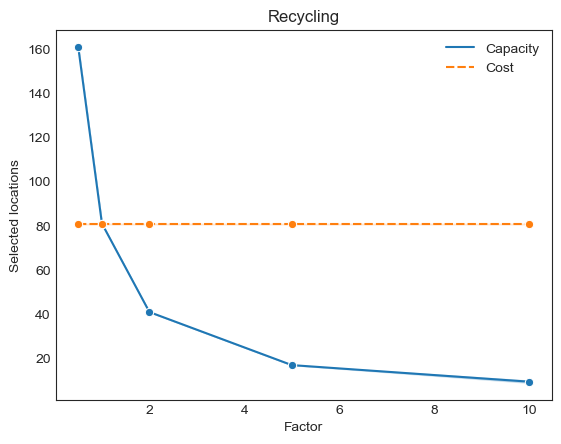

In [136]:
figure = sns.lineplot(x='Factor', y='Selected locations', data=rec_cap_locs_data_df.loc[rec_cap_locs_data_df['Facility'] == 'Recycling'], marker='o', hue='Analysis', style="Analysis", )
figure.legend(frameon=False)
figure.set(title='Recycling')

#### Manufacturing

[Text(0.5, 1.0, 'Manufacturing')]

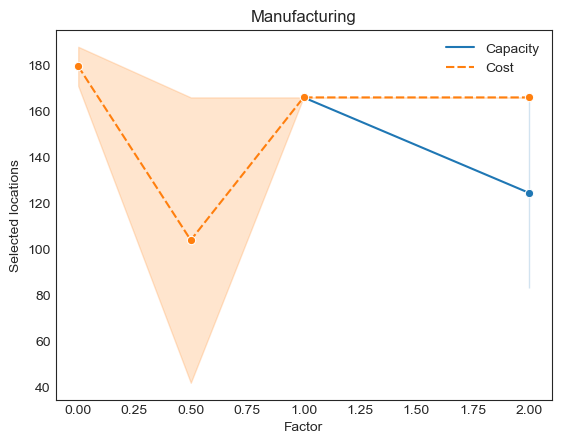

In [137]:
figure = sns.lineplot(x='Factor', y='Selected locations', data=rec_cap_locs_data_df.loc[rec_cap_locs_data_df['Facility'] == 'Manufacturing'], marker='o', hue='Analysis', style="Analysis", )
figure.legend(frameon=False)
figure.set(title='Manufacturing')

### Grid plot

#### Recycling Capacity Utilization Factor

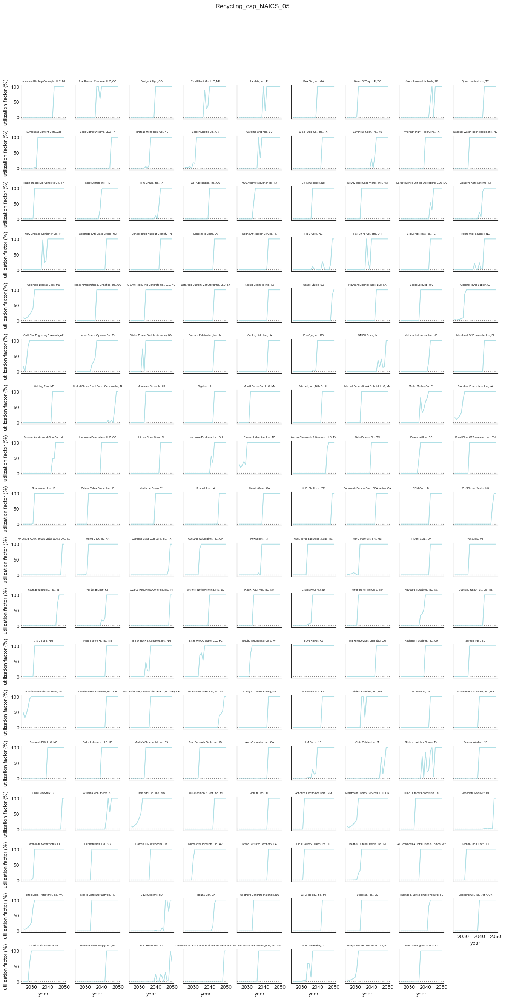

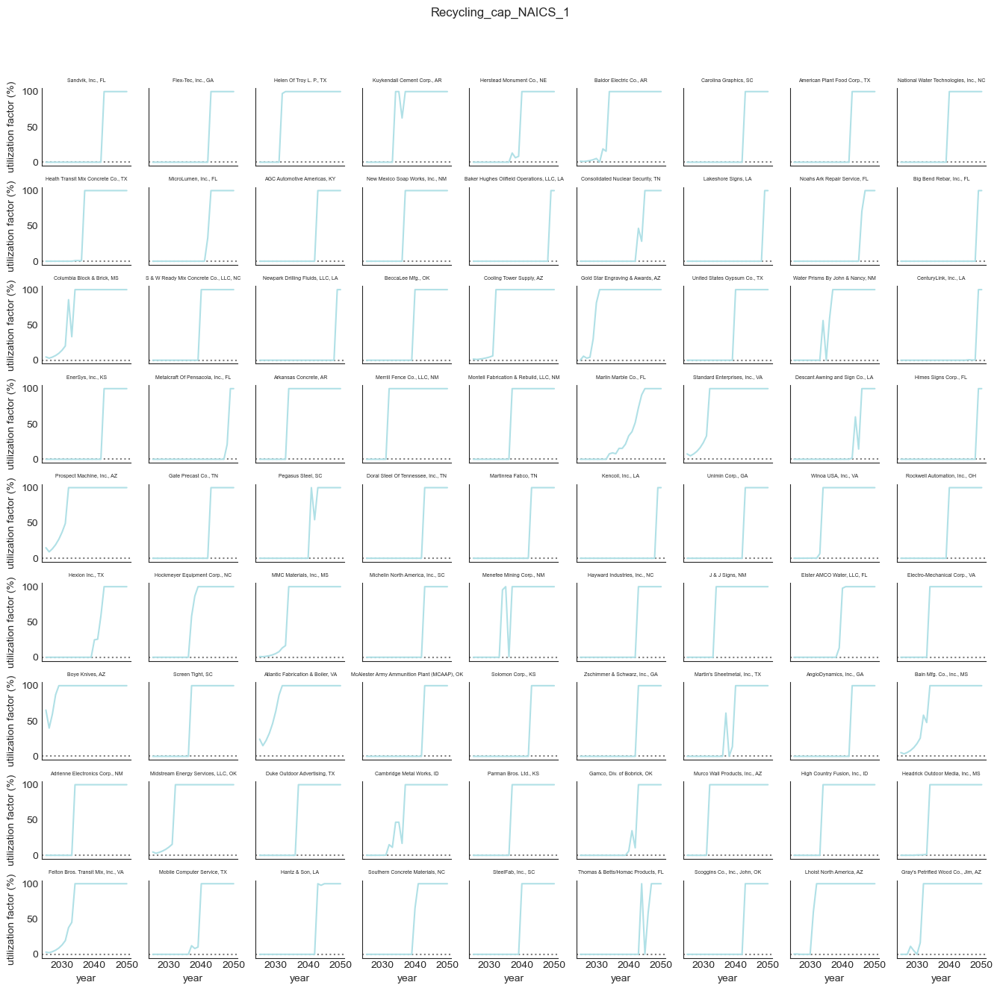

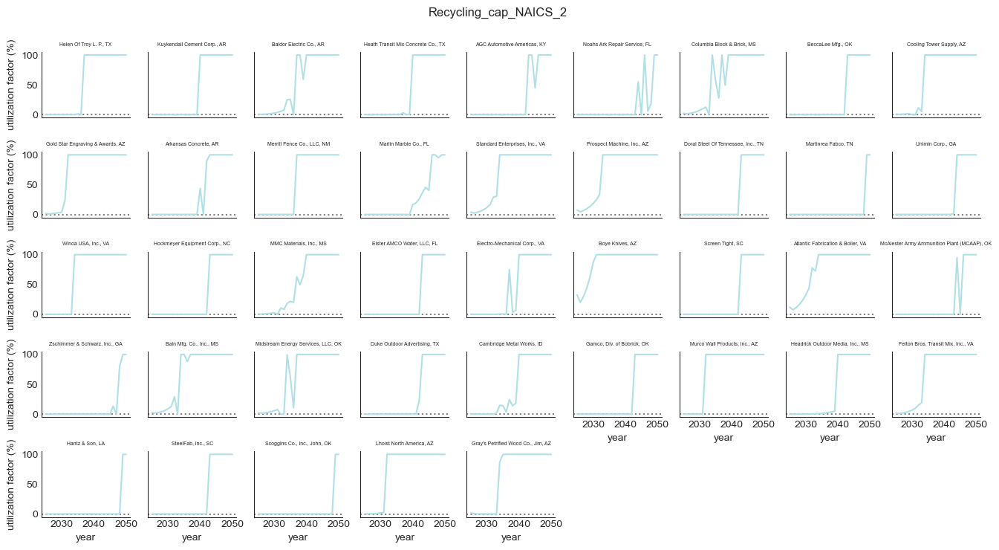

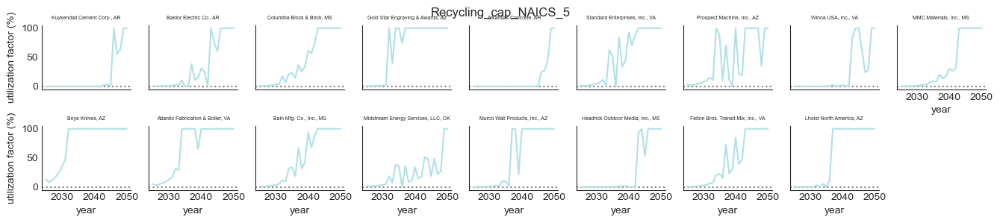

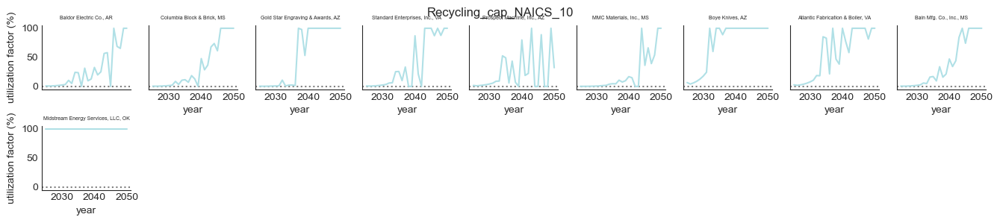

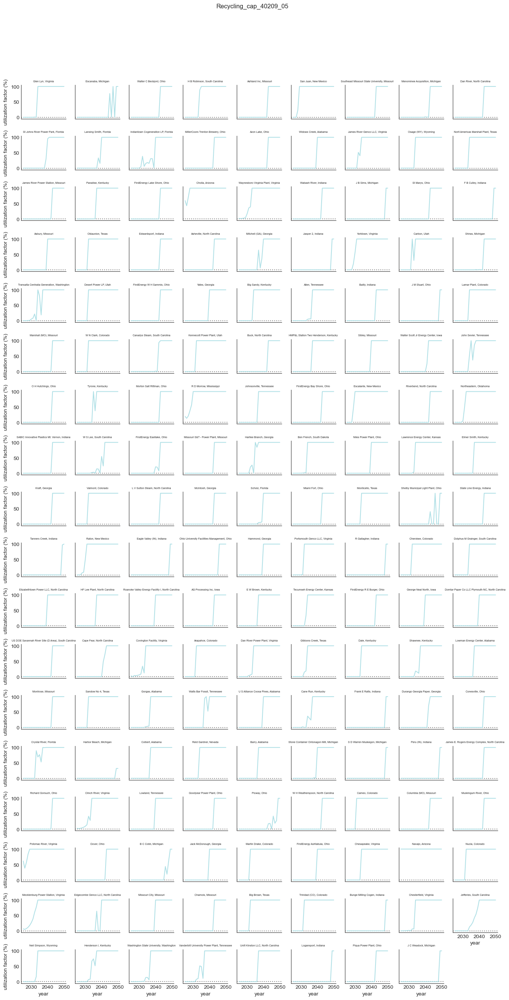

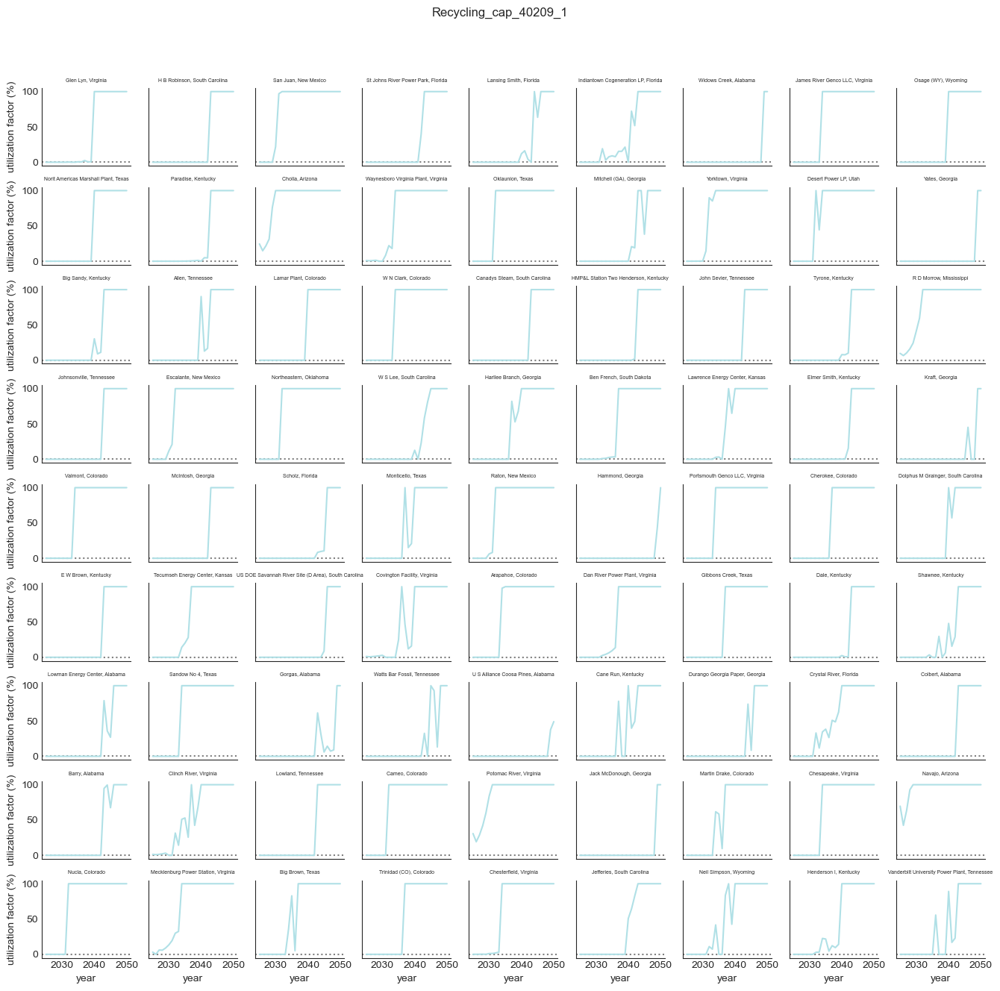

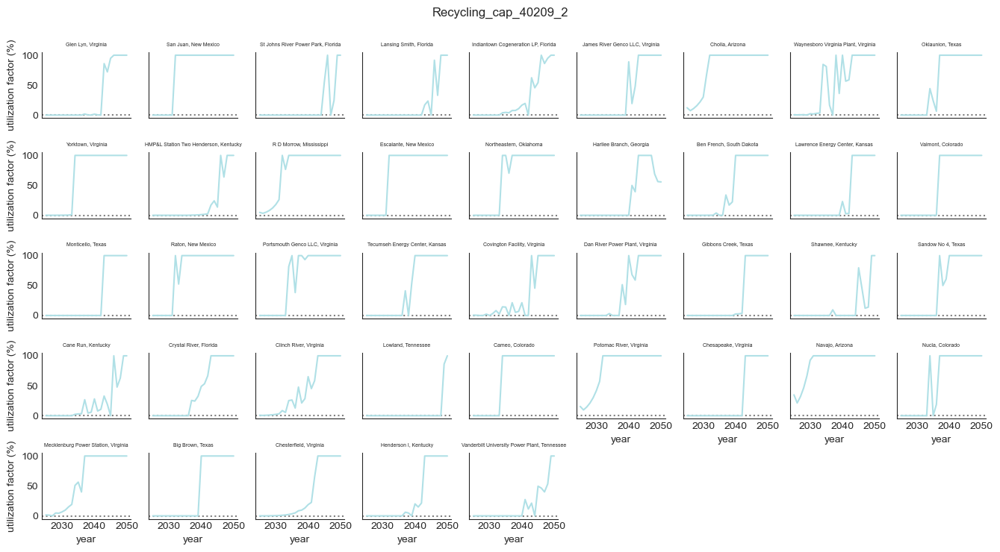

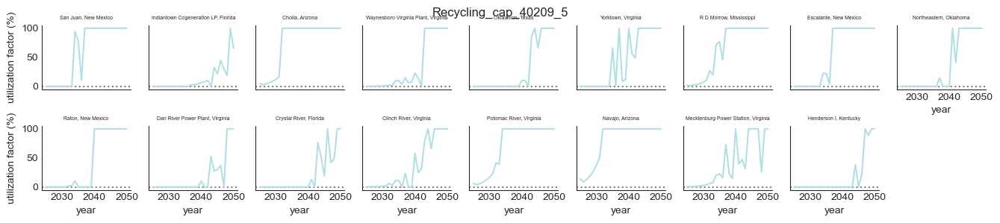

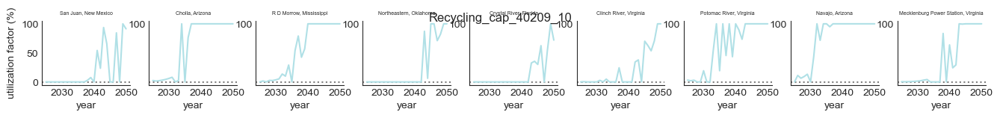

In [173]:
for files in recycling_files_cap:
# Initialize a grid of plots with an Axes for each walk
    grid = sns.FacetGrid(globals()['%s_plants' % (files)], col="location name",
                         col_wrap=9, height=1.5)

    # Draw a horizontal line to show the starting point
    grid.refline(y=0, linestyle=":")


    grid.map(plt.plot, "year", "utilization factor (%)", color="powderblue")

    # Adjust the tick positions, labels and 
    #sns.set(font_scale=0.1)
    grid.set_titles(row_template = '{row_name}', col_template = '{col_name}', size=5)

    grid.fig.tight_layout(w_pad=1)
    grid.fig.subplots_adjust(top=0.9)
    grid.fig.suptitle(f"{files}")


    plt.savefig(os.path.join(cwd, f"grid_before_update/grid_{files}_cap_uf.png"));


#### Recycling Capacity Total Cost

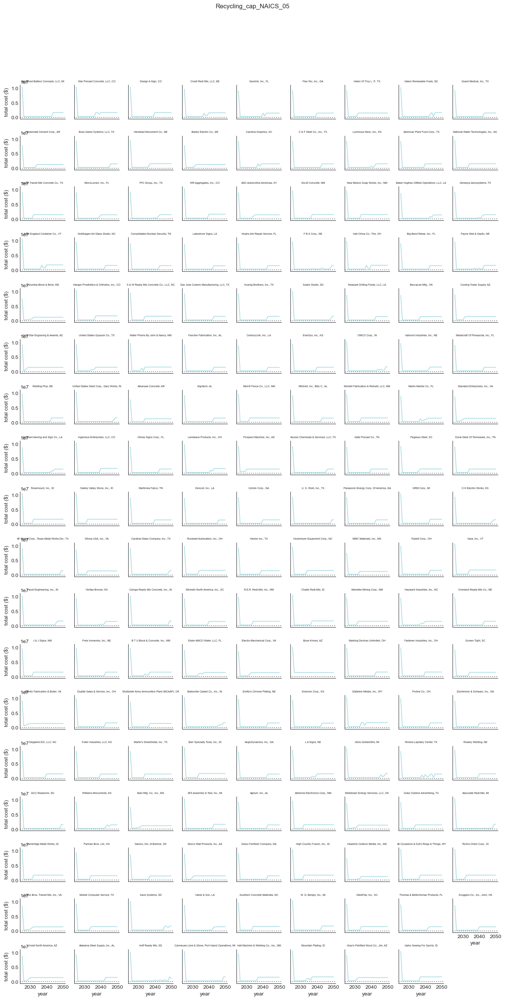

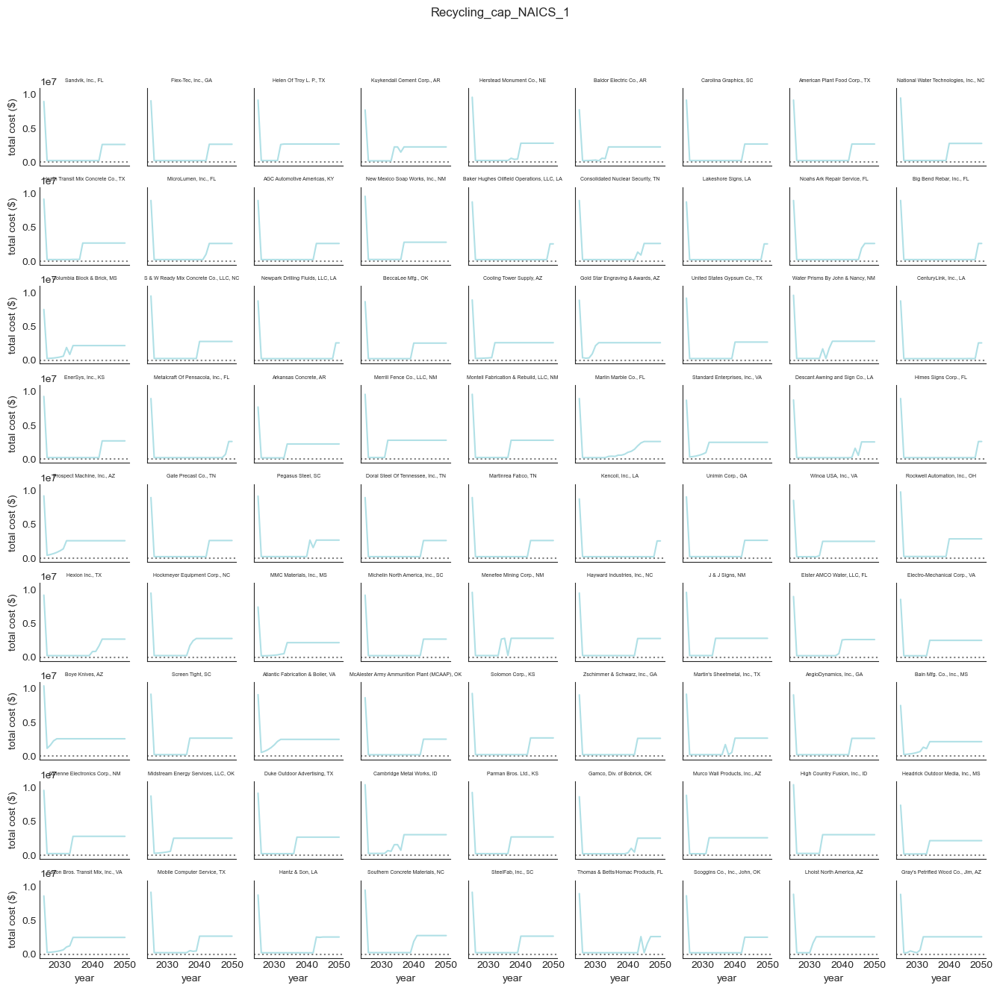

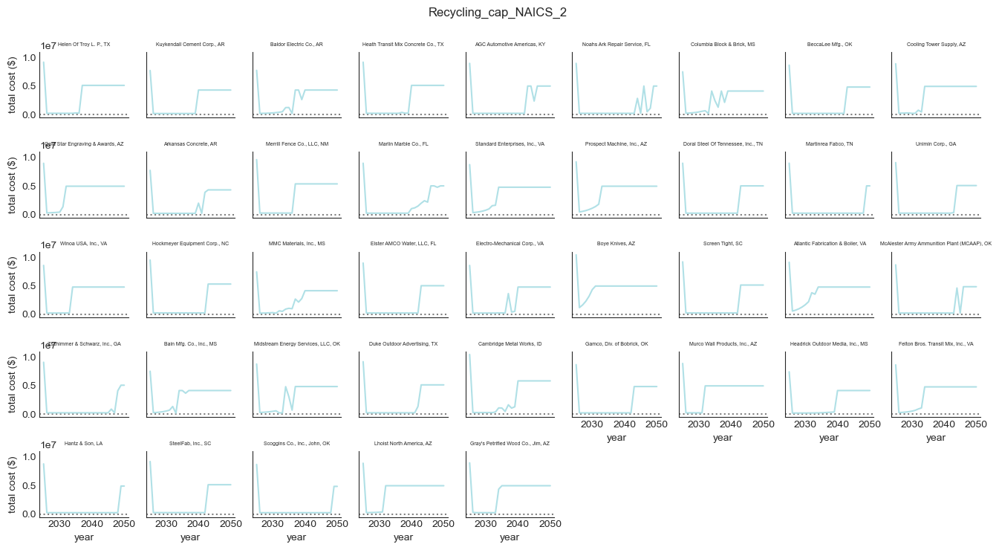

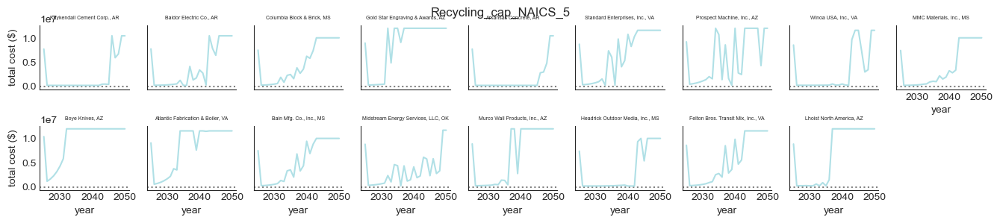

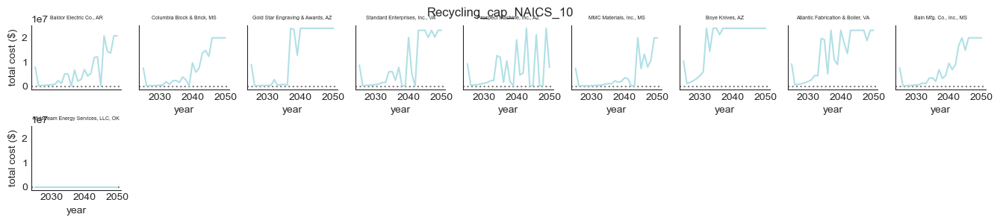

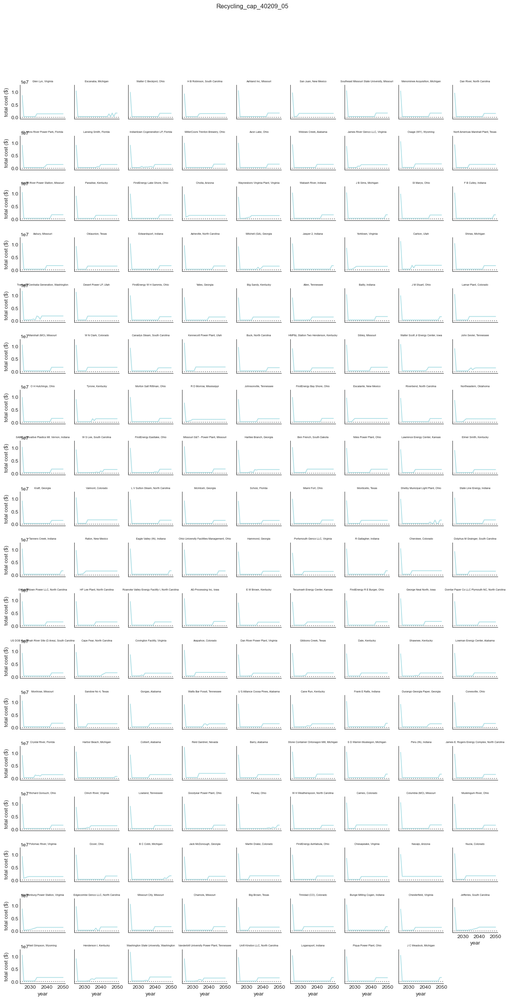

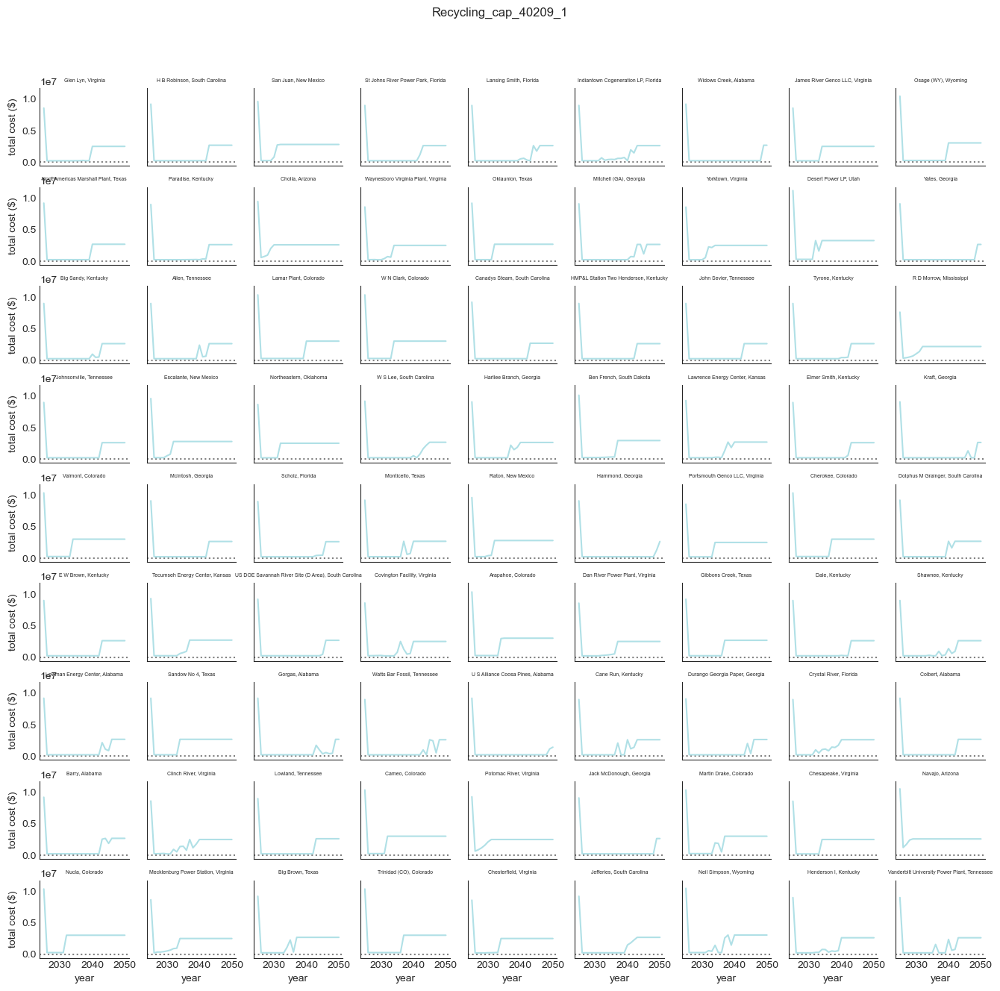

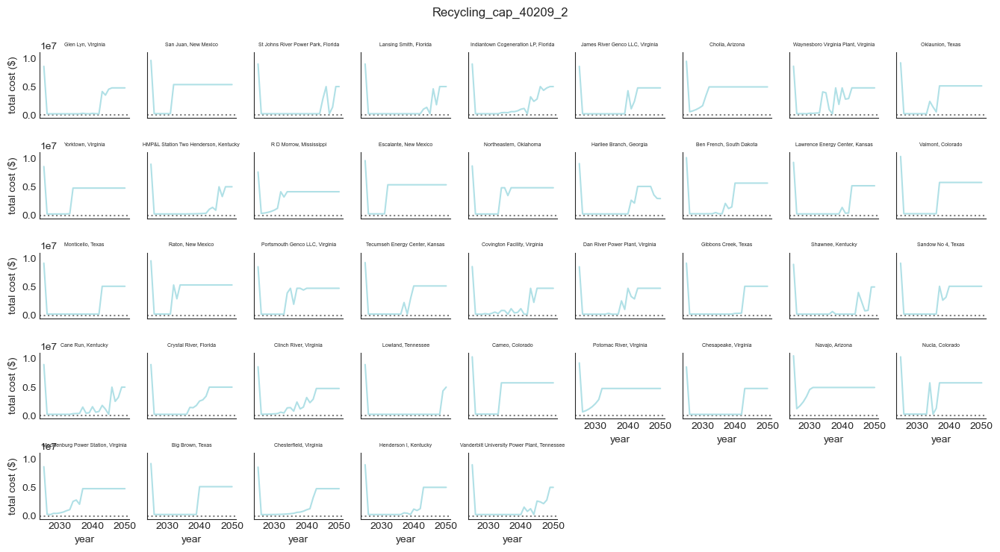

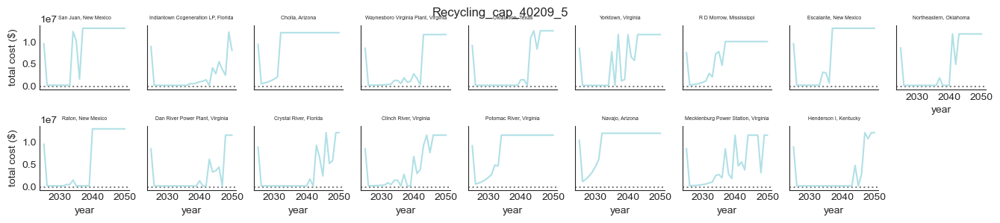

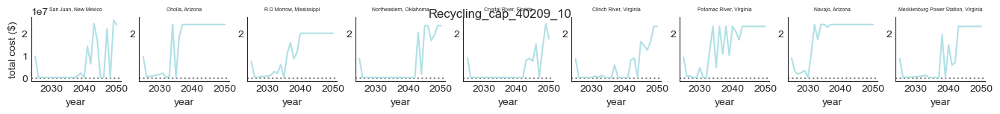

In [174]:
for files in recycling_files_cap:
# Initialize a grid of plots with an Axes for each walk
    grid = sns.FacetGrid(globals()['%s_plants' % (files)], col="location name",
                         col_wrap=9, height=1.5)

    # Draw a horizontal line to show the starting point
    grid.refline(y=0, linestyle=":")


    grid.map(plt.plot, "year", "total cost ($)", color="powderblue")

    # Adjust the tick positions, labels and 
    #sns.set(font_scale=0.1)
    grid.set_titles(row_template = '{row_name}', col_template = '{col_name}', size=5)

    grid.fig.tight_layout(w_pad=1)
    grid.fig.subplots_adjust(top=0.9)
    grid.fig.suptitle(f"{files}")


    plt.savefig(os.path.join(cwd, f"grid_before_update/grid_{files}_cap_totcost.png"));


#### Recycling Cost Utilization Factor

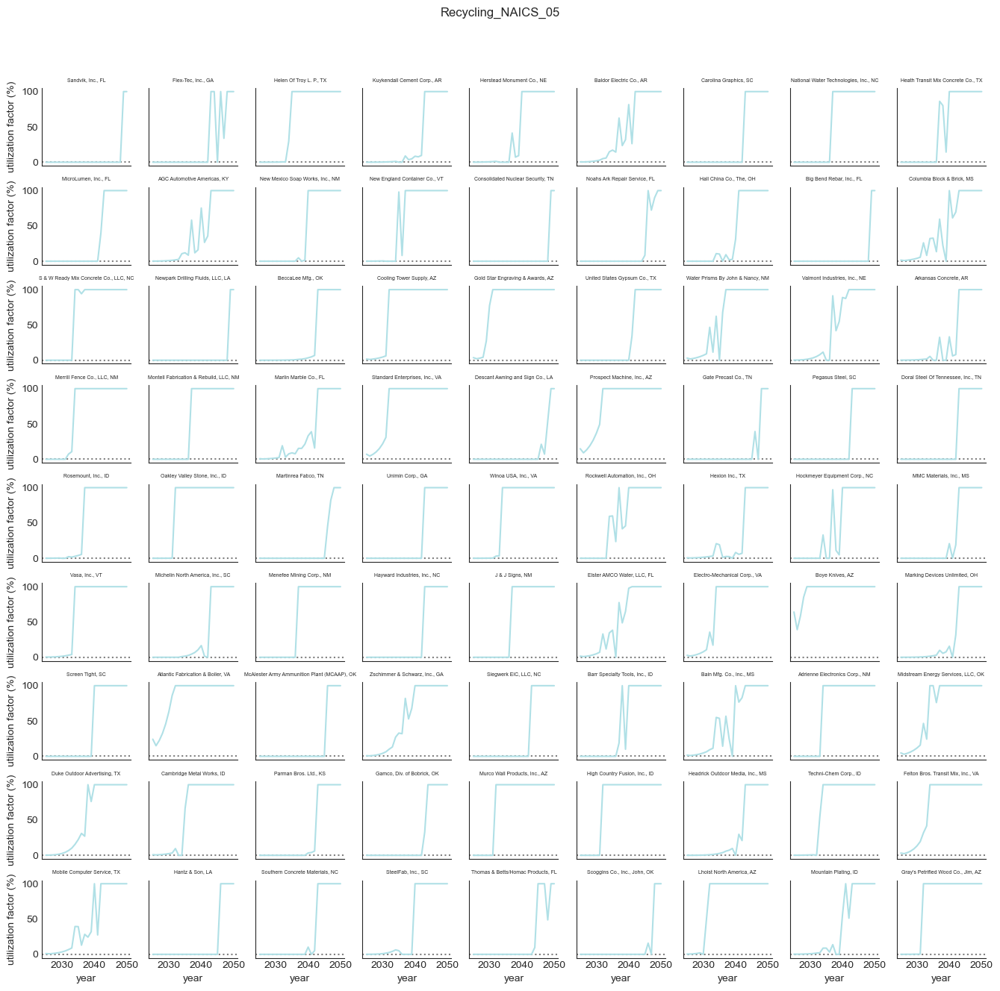

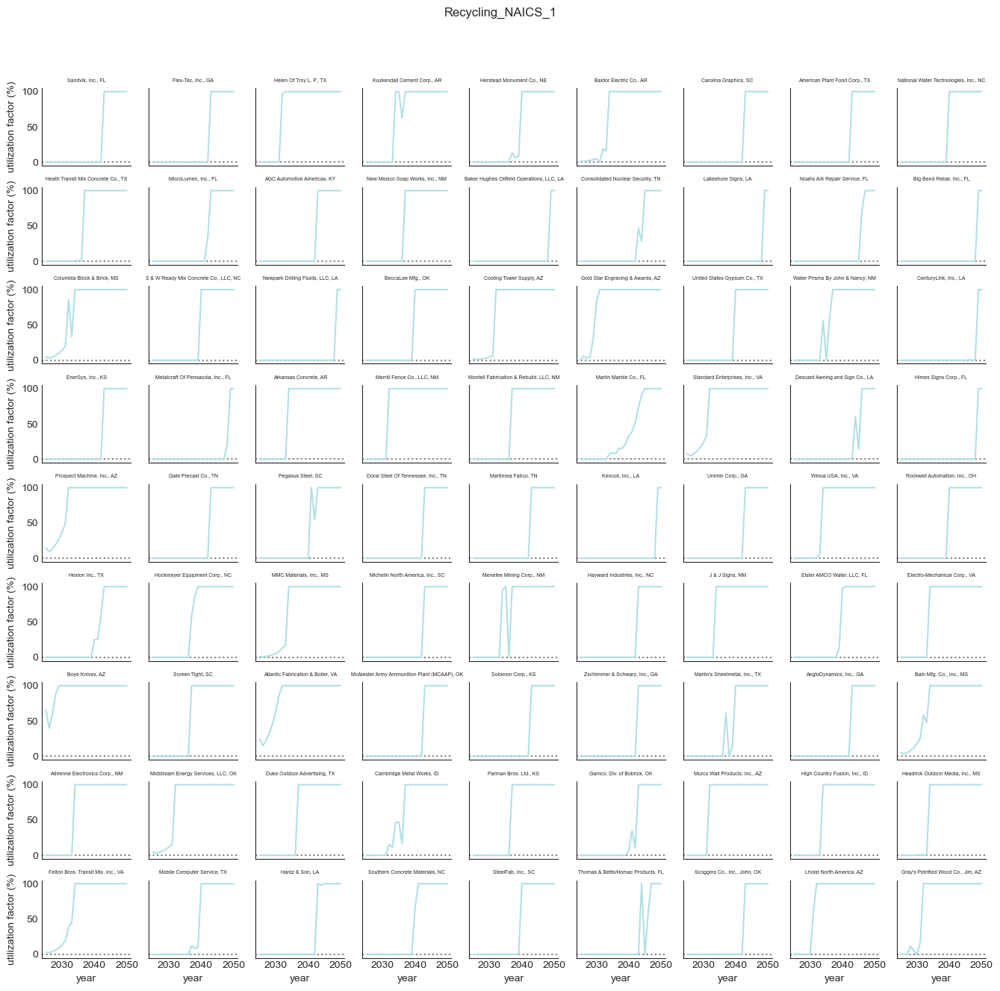

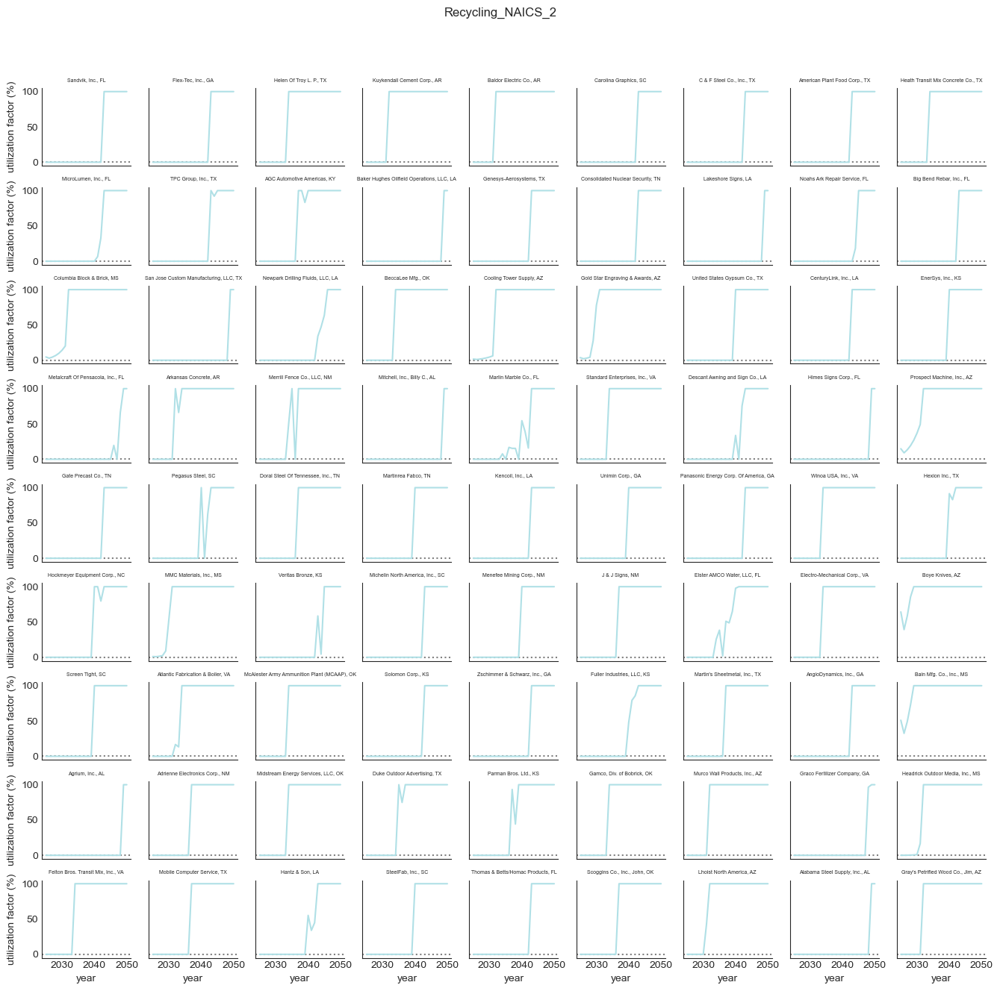

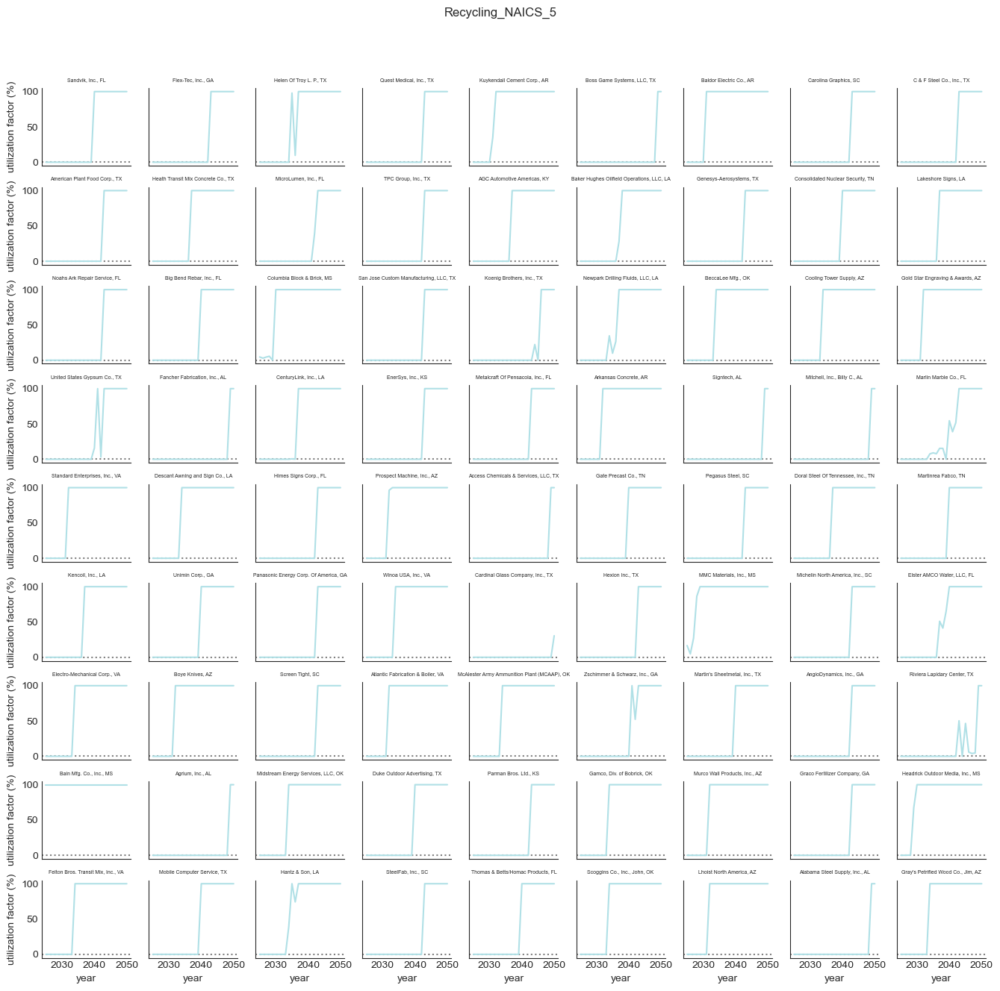

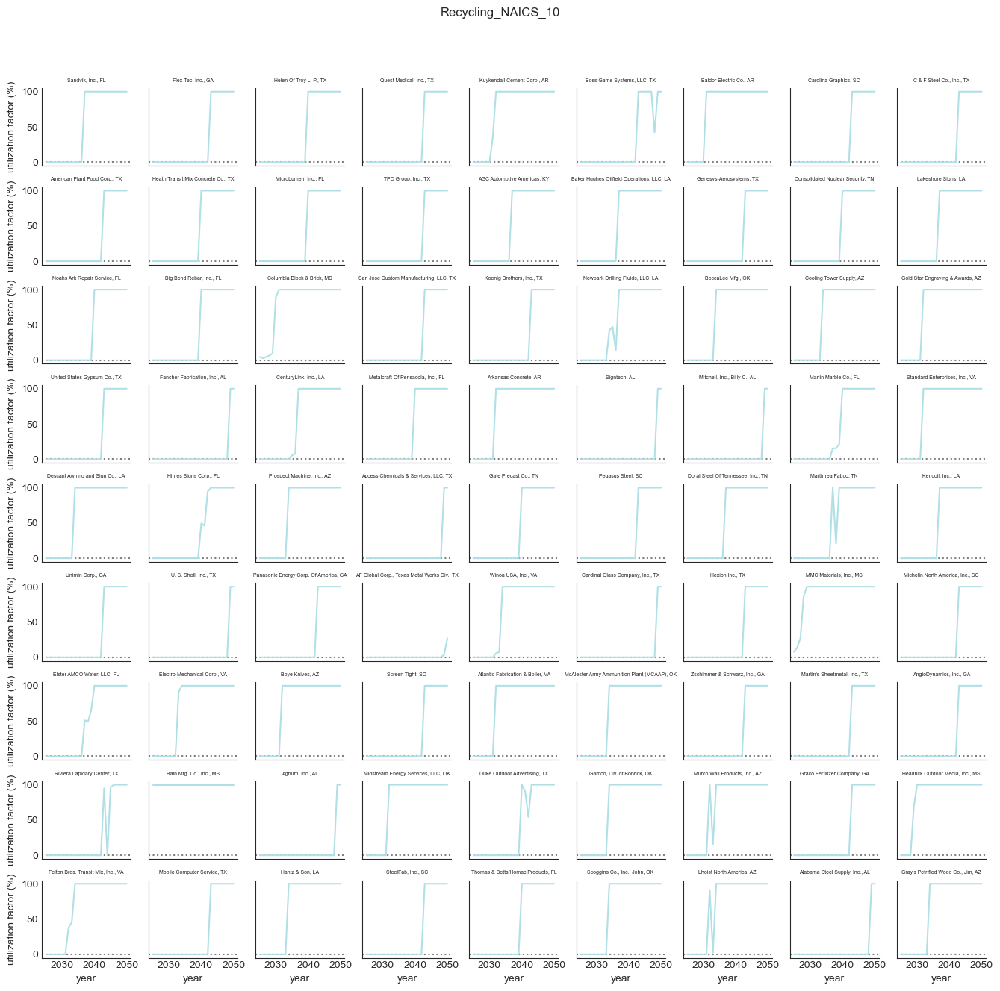

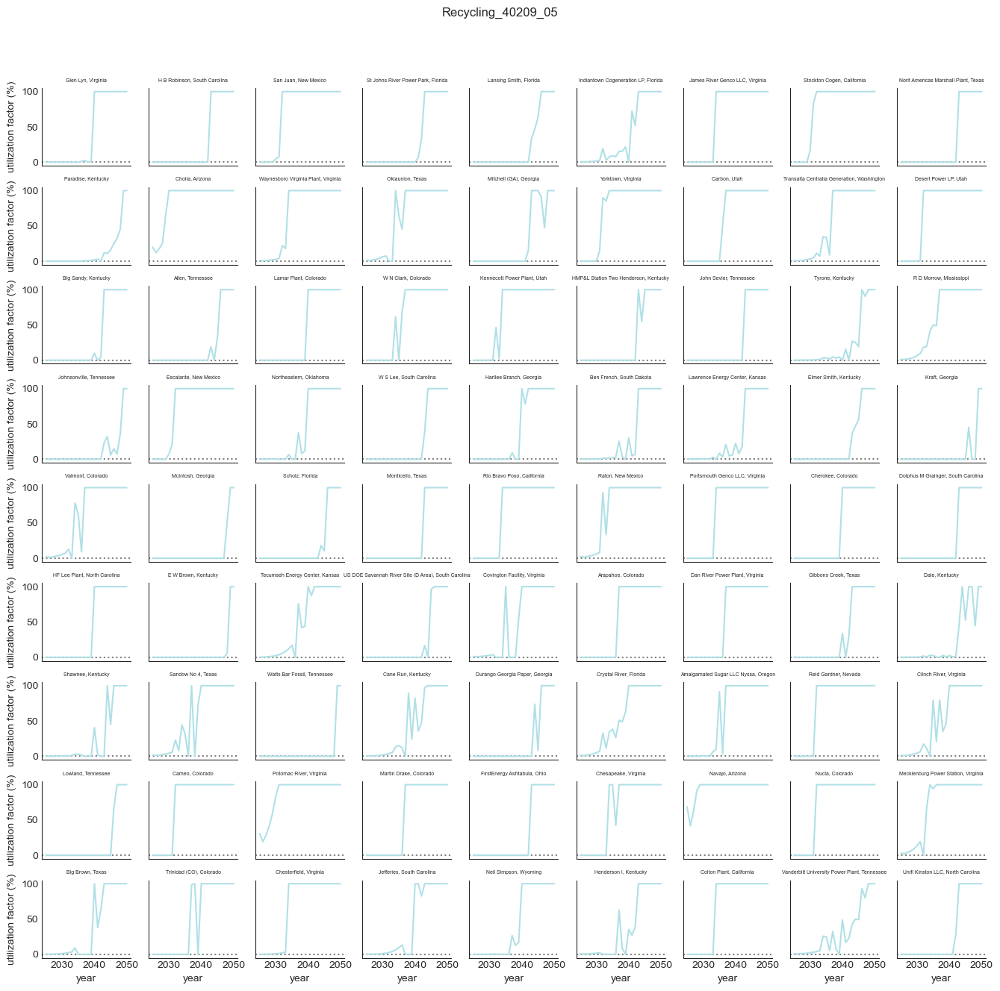

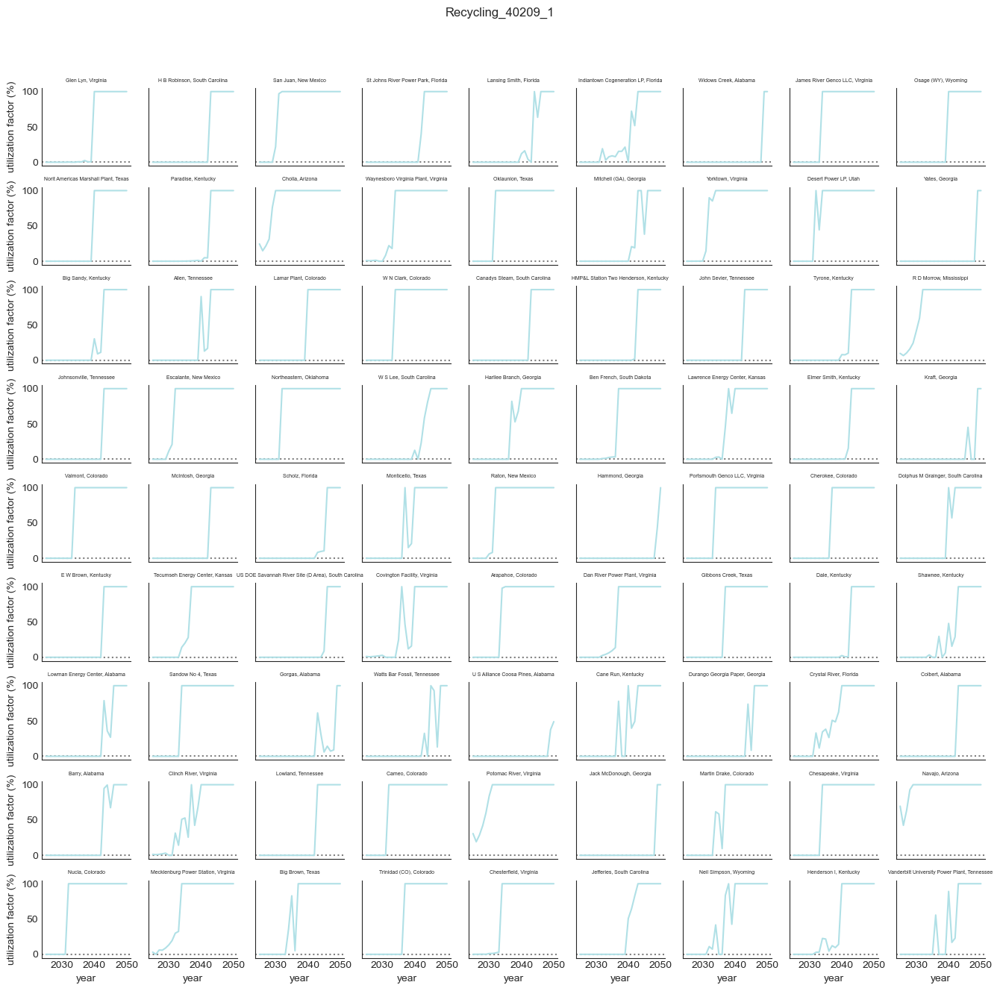

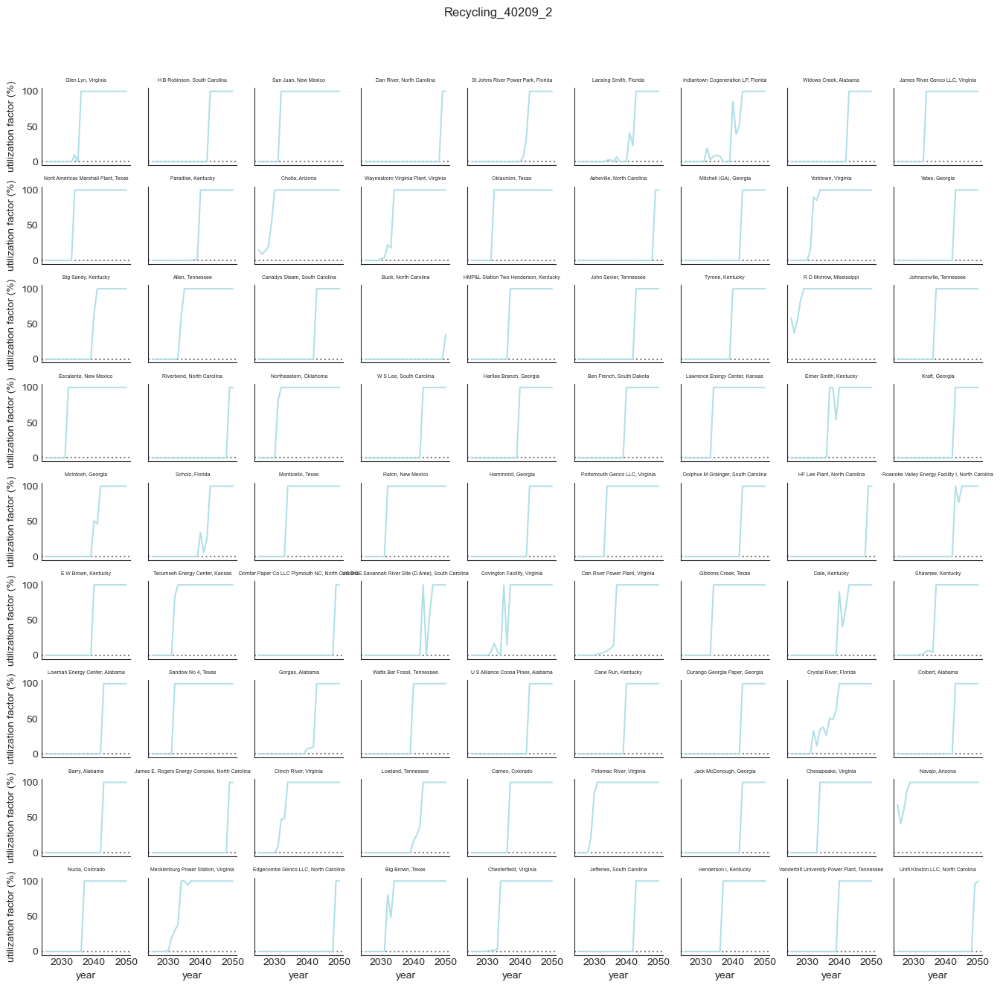

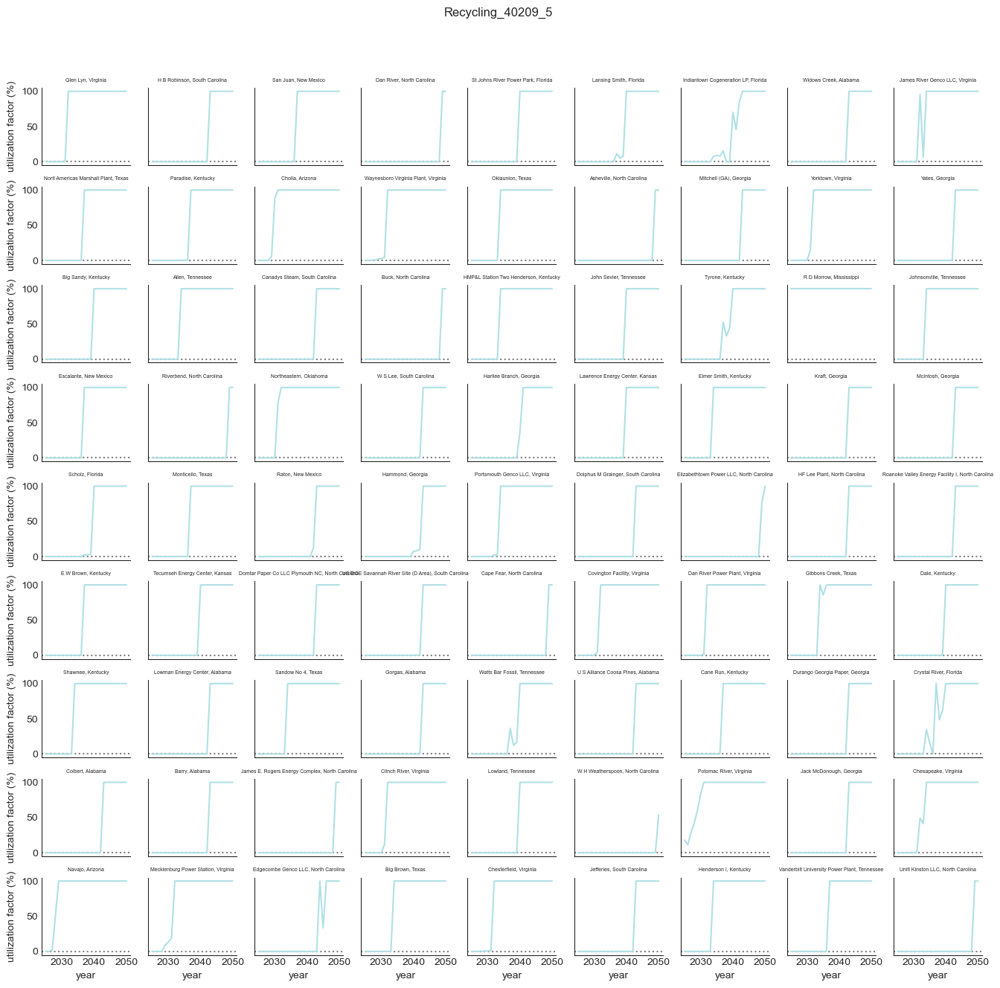

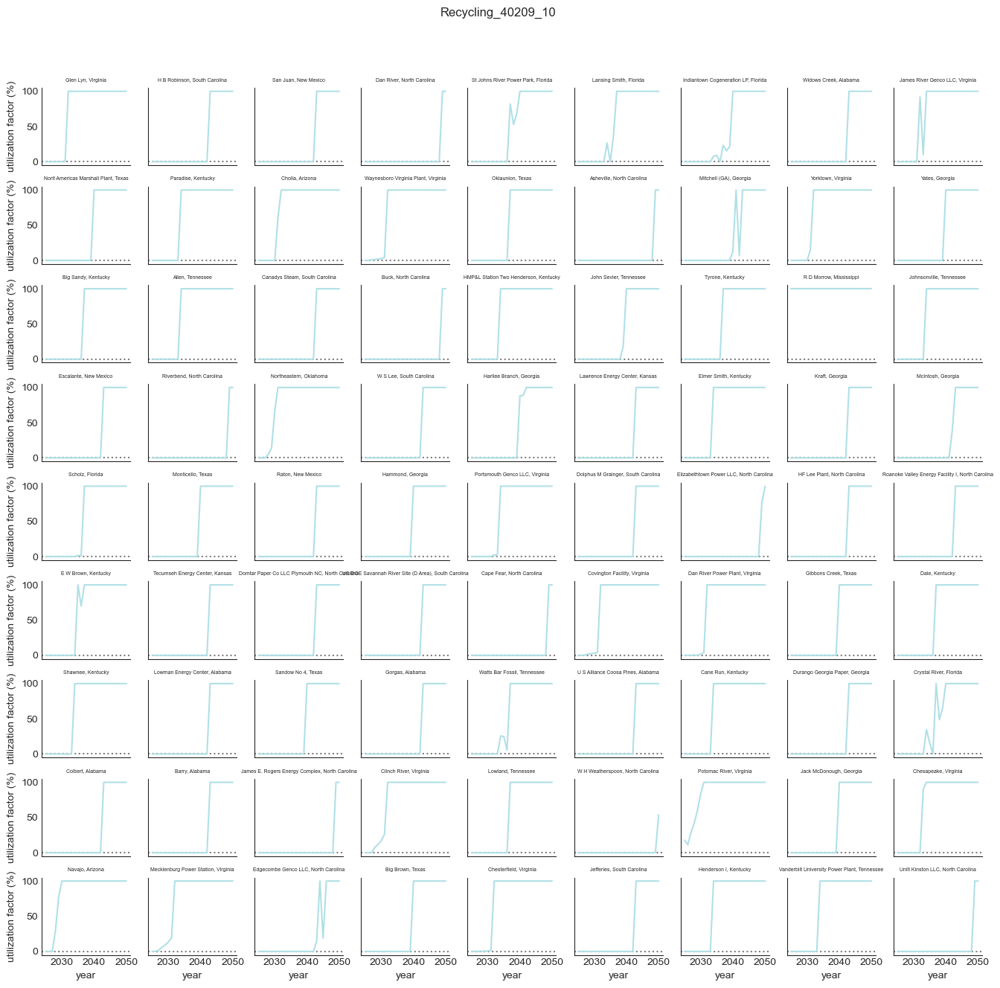

In [175]:
for files in recycling_files_cost:
# Initialize a grid of plots with an Axes for each walk
# Initialize a grid of plots with an Axes for each walk
    grid = sns.FacetGrid(globals()['%s_plants' % (files)], col="location name",
                         col_wrap=9, height=1.5)

    # Draw a horizontal line to show the starting point
    grid.refline(y=0, linestyle=":")


    grid.map(plt.plot, "year", "utilization factor (%)", color="powderblue")

    # Adjust the tick positions, labels and 
    #sns.set(font_scale=0.1)
    grid.set_titles(row_template = '{row_name}', col_template = '{col_name}', size=5)

    grid.fig.tight_layout(w_pad=1)
    grid.fig.subplots_adjust(top=0.9)
    grid.fig.suptitle(f"{files}")


    plt.savefig(os.path.join(cwd, f"grid_before_update/grid_{files}_cost_uf.png"));


#### Recycling Cost Total Cost

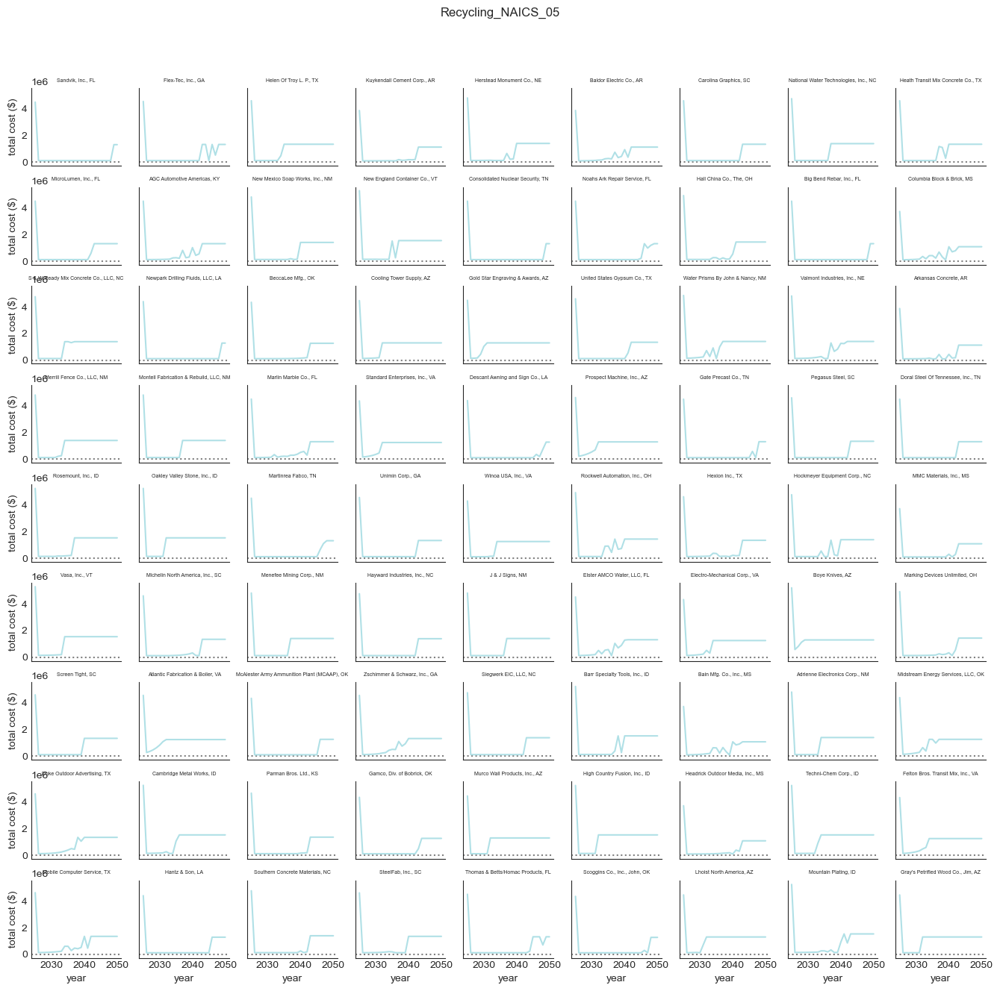

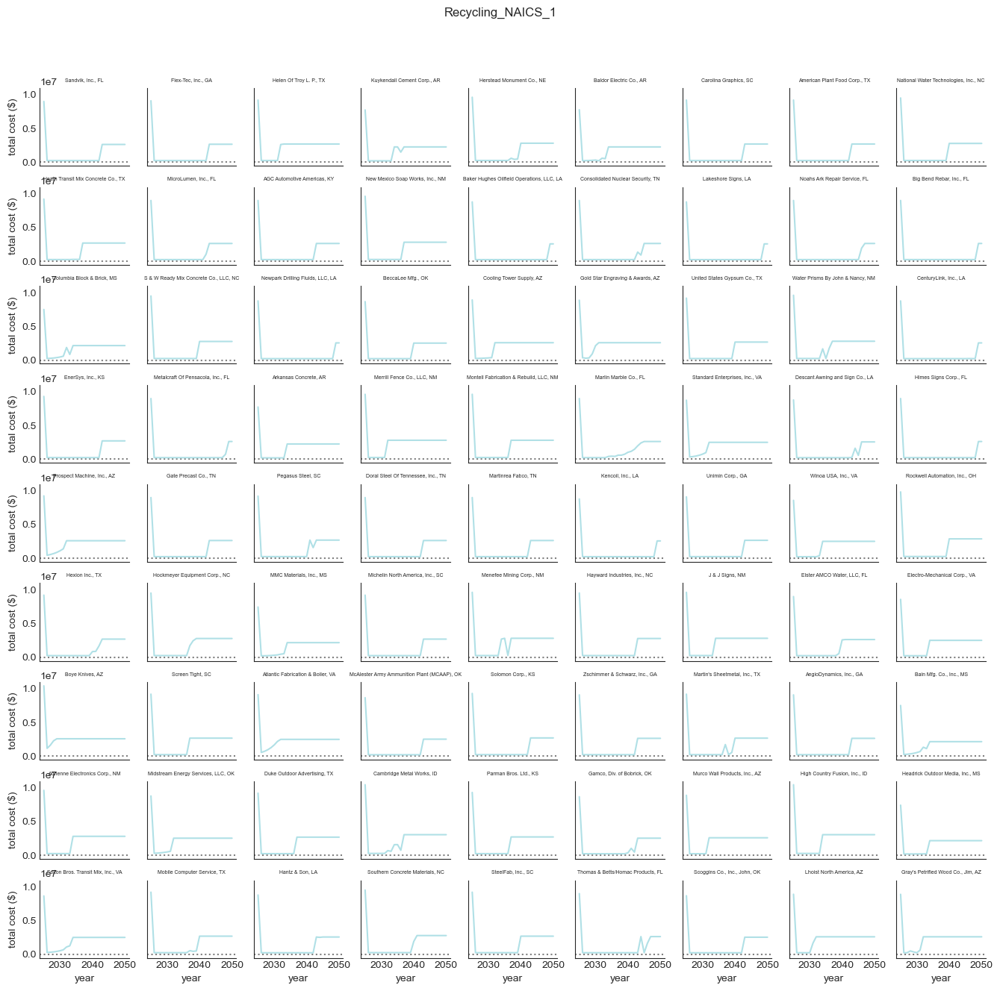

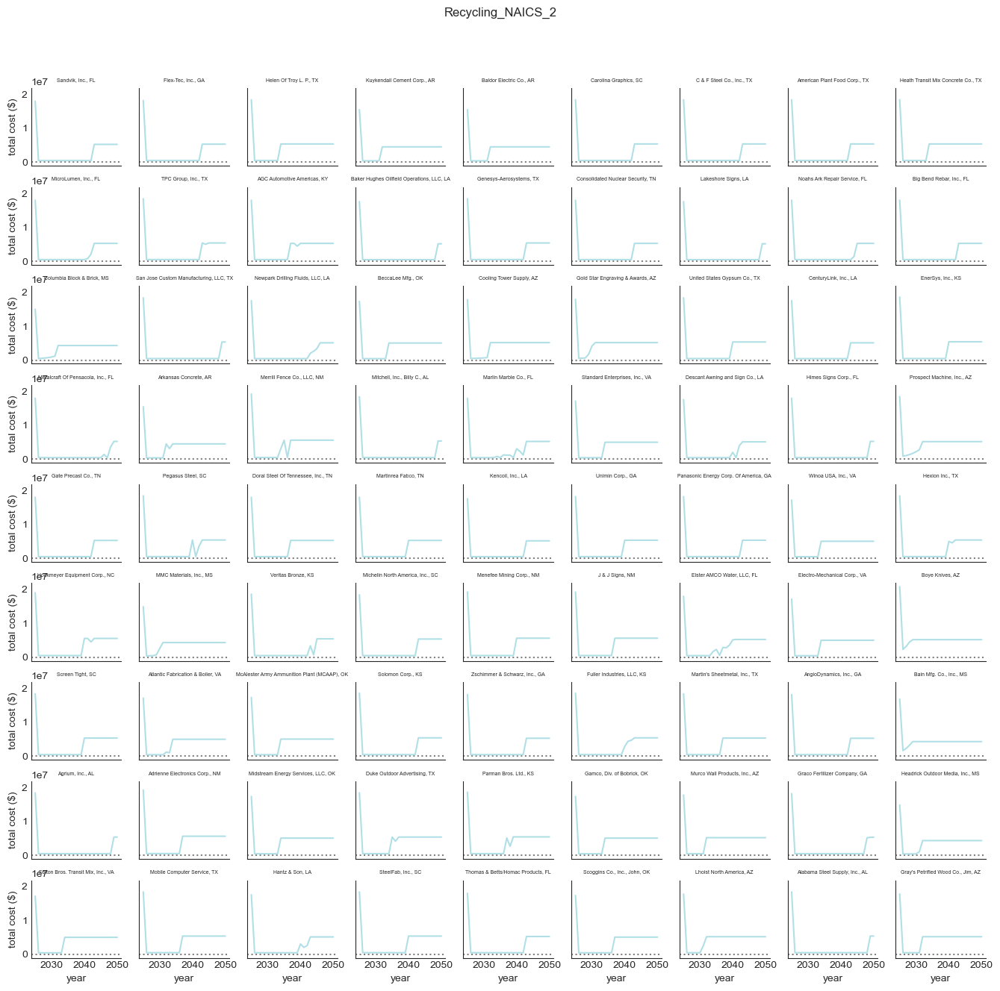

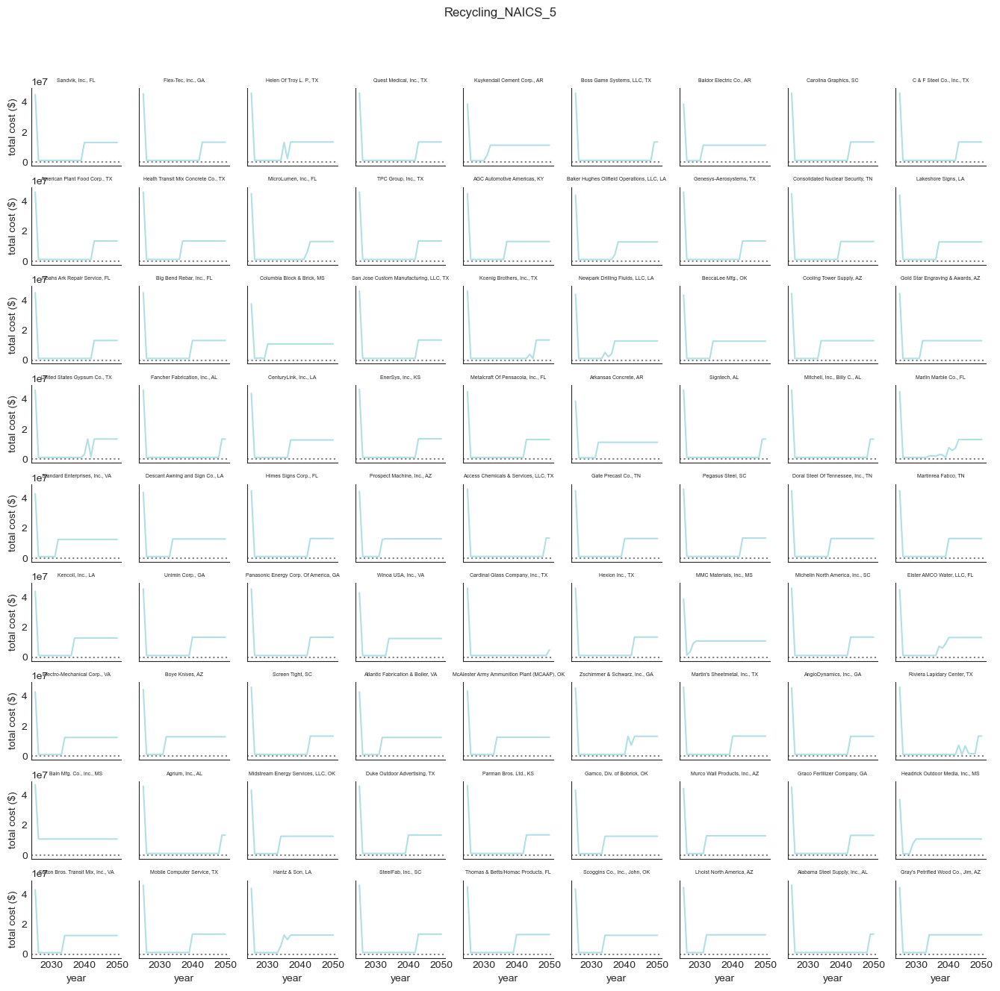

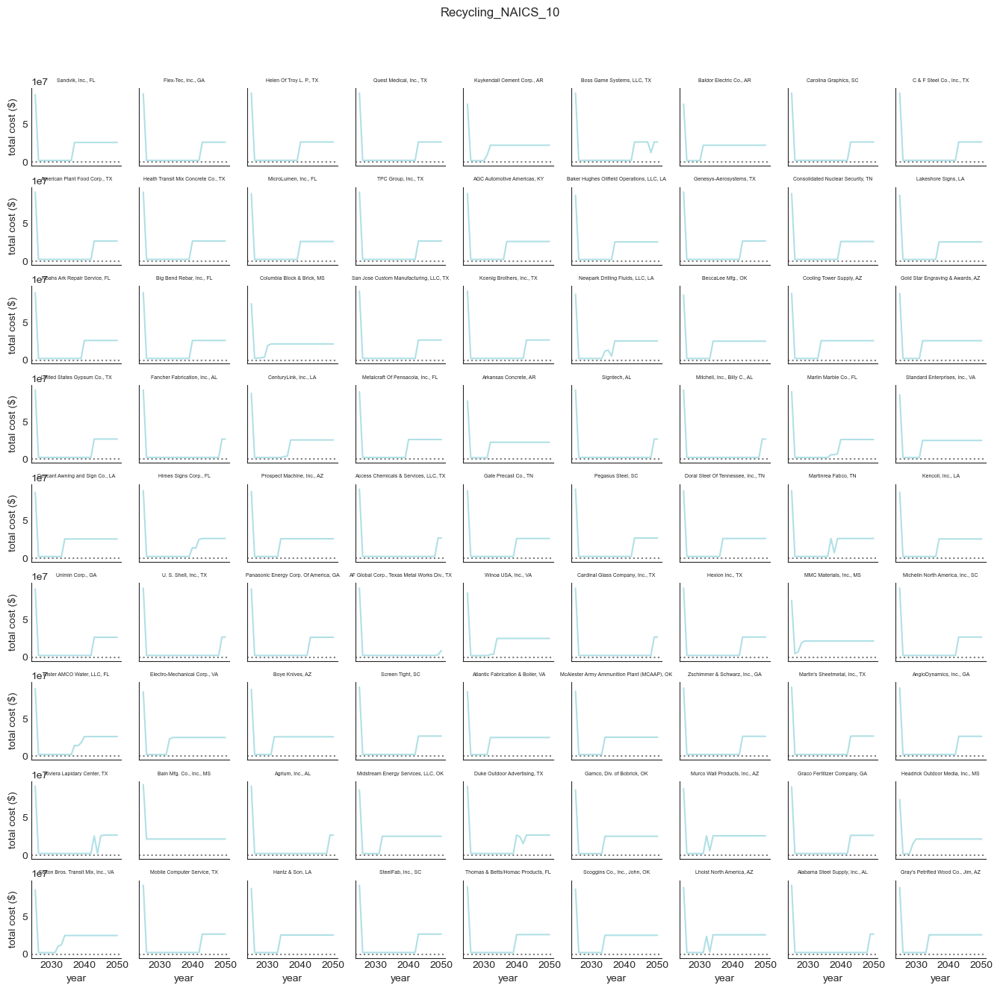

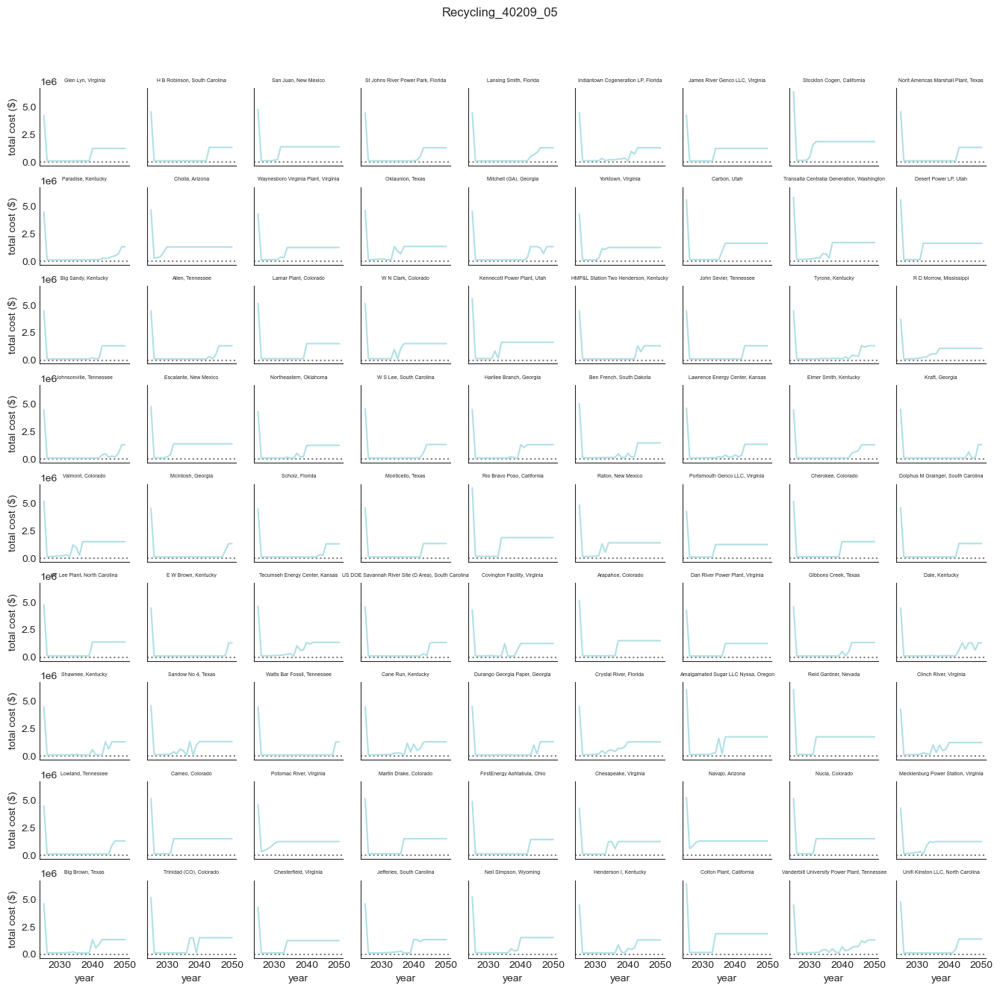

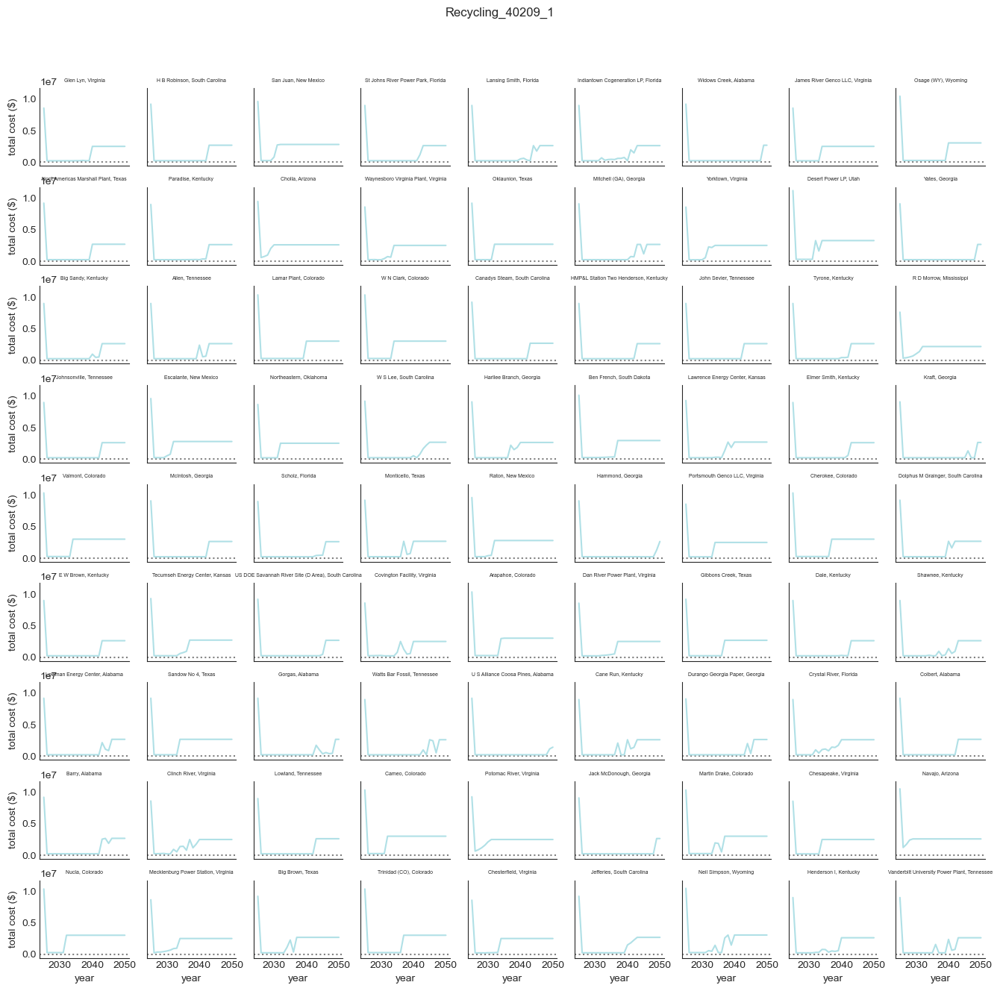

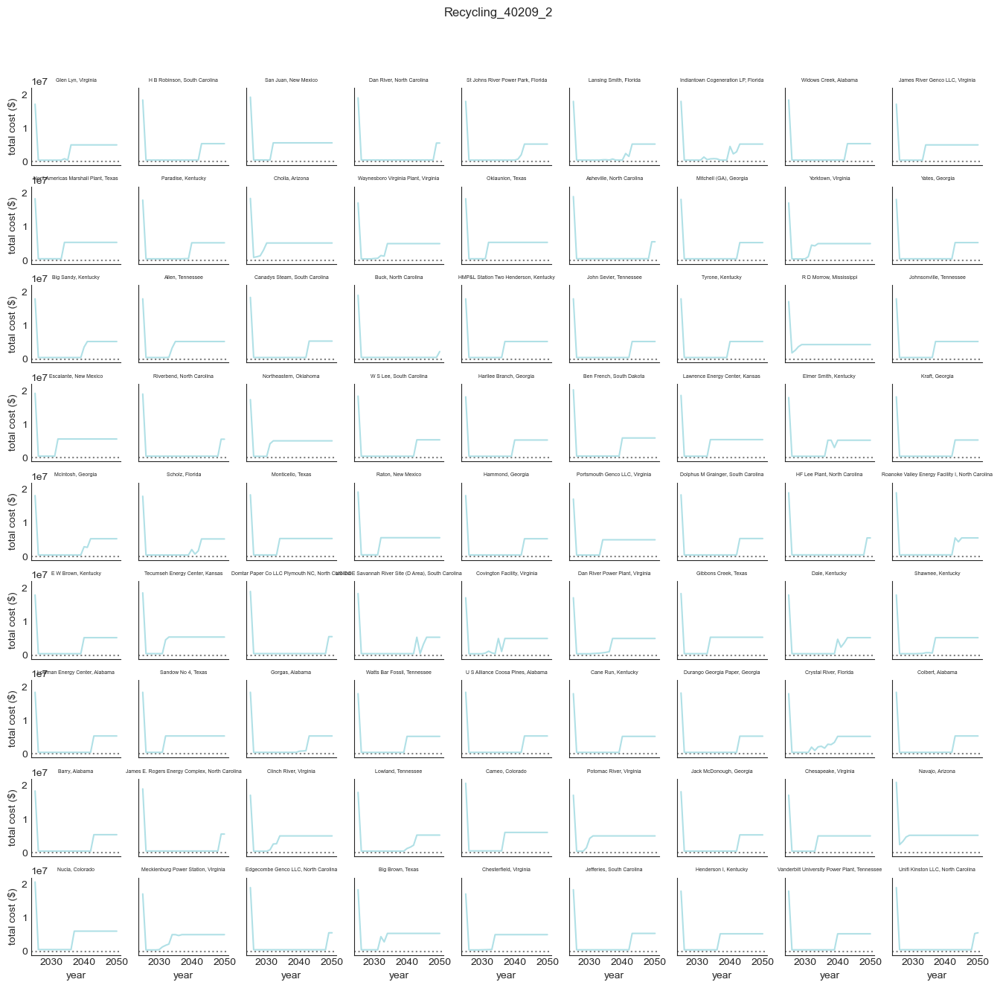

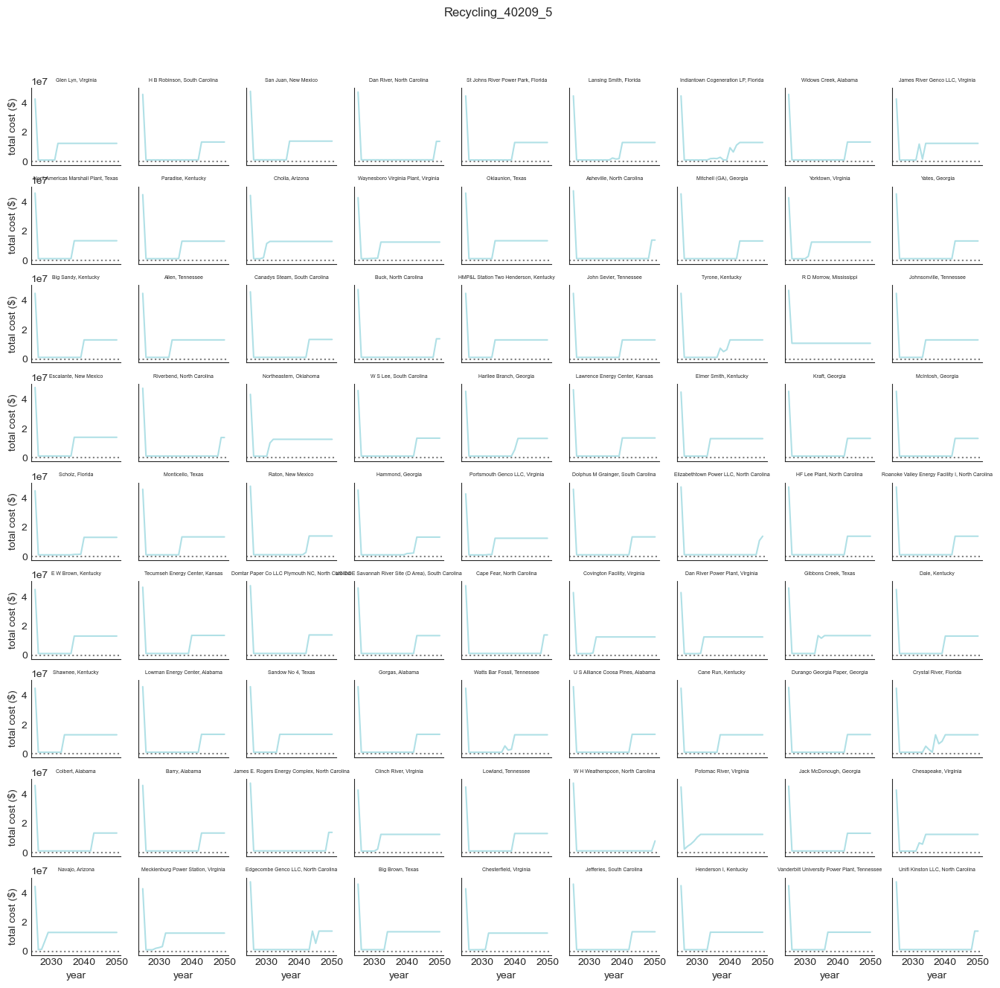

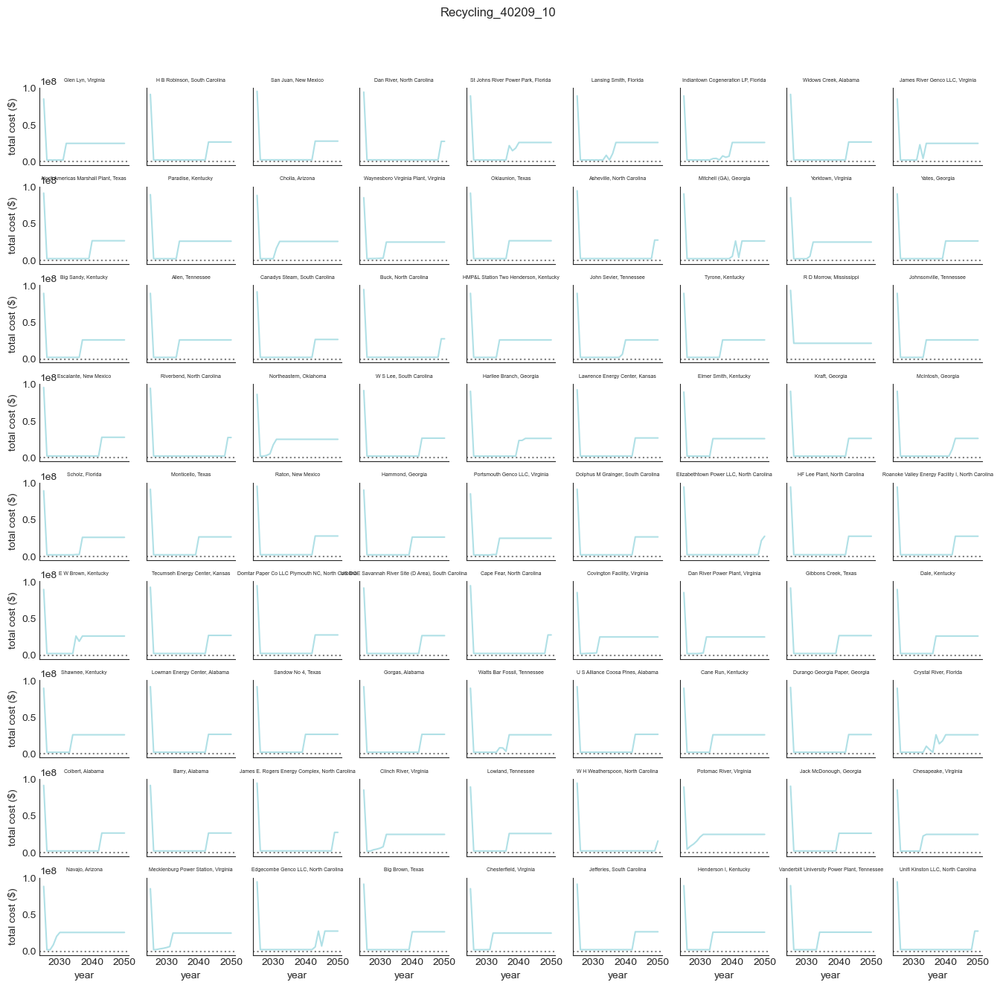

In [176]:
for files in recycling_files_cost:
# Initialize a grid of plots with an Axes for each walk
    grid = sns.FacetGrid(globals()['%s_plants' % (files)], col="location name",
                         col_wrap=9, height=1.5)

    # Draw a horizontal line to show the starting point
    grid.refline(y=0, linestyle=":")


    grid.map(plt.plot, "year", "total cost ($)", color="powderblue")

    # Adjust the tick positions, labels and 
    #sns.set(font_scale=0.1)
    grid.set_titles(row_template = '{row_name}', col_template = '{col_name}', size=5)

    grid.fig.tight_layout(w_pad=1)
    grid.fig.subplots_adjust(top=0.9)
    grid.fig.suptitle(f"{files}")


    plt.savefig(os.path.join(cwd, f"grid_before_update/grid_{files}_cost_totcost.png"));


#### Manufacturing Capacity Utilization Factor

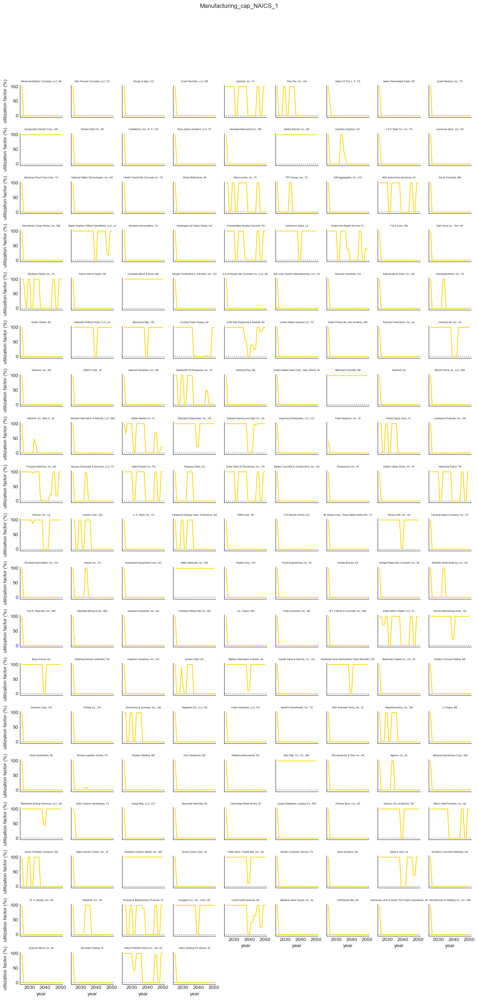

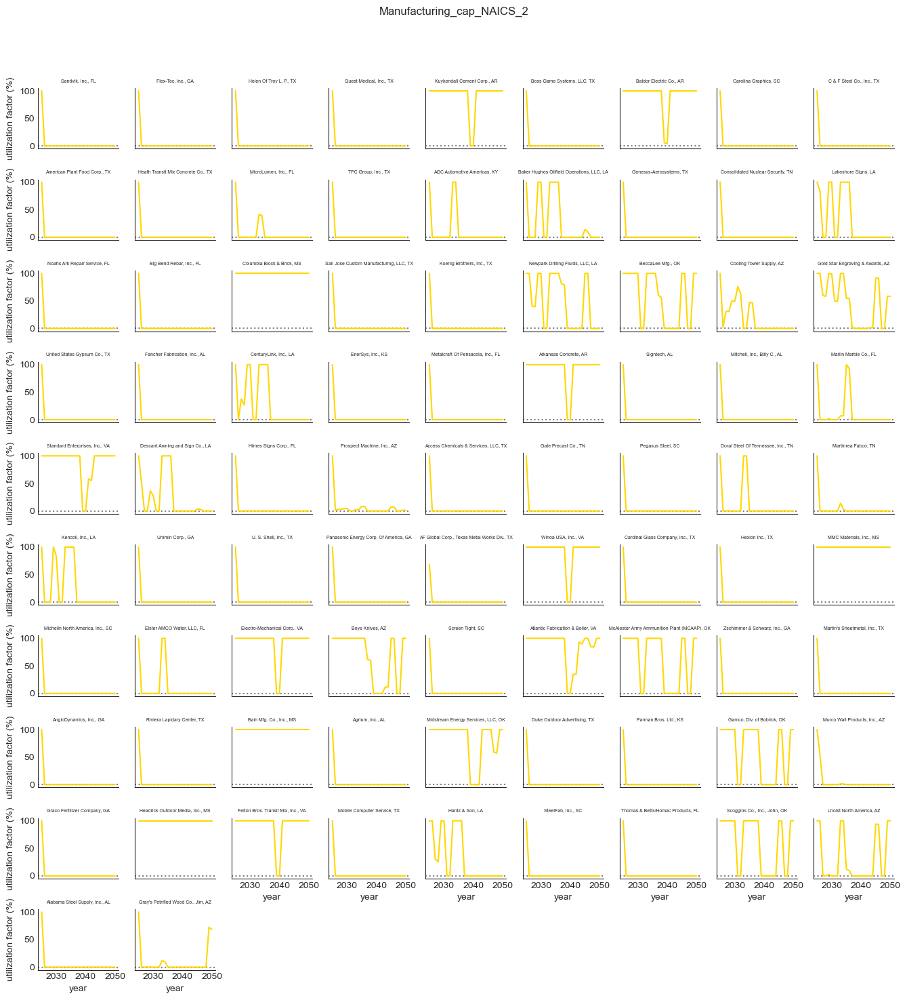

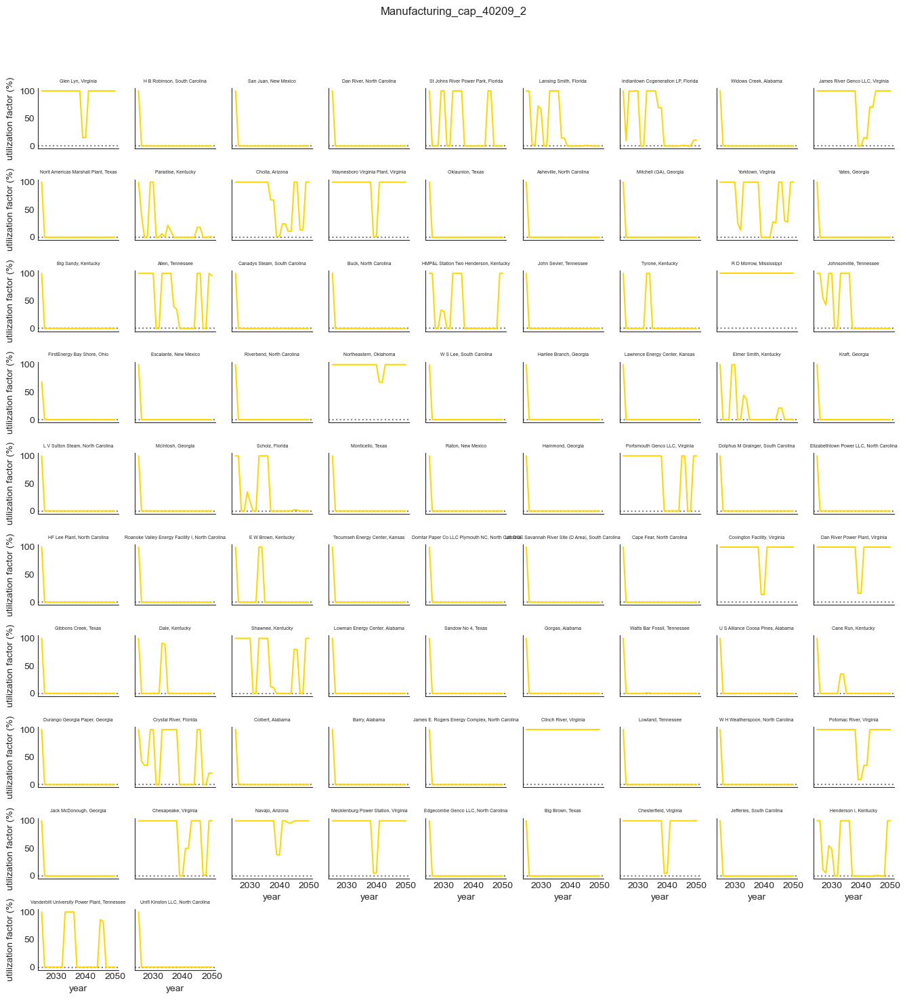

In [177]:
for files in manufacturing_files_cap:
# Initialize a grid of plots with an Axes for each walk
    grid = sns.FacetGrid(globals()['%s_plants' % (files)], col="location name",
                         col_wrap=9, height=1.5)

    # Draw a horizontal line to show the starting point
    grid.refline(y=0, linestyle=":")


    grid.map(plt.plot, "year", "utilization factor (%)", color='gold')

    # Adjust the tick positions, labels and 
    #sns.set(font_scale=0.1)
    grid.set_titles(row_template = '{row_name}', col_template = '{col_name}', size=5)

    grid.fig.tight_layout(w_pad=1)
    grid.fig.subplots_adjust(top=0.9)
    grid.fig.suptitle(f"{files}")


    plt.savefig(os.path.join(cwd, f"grid_before_update/grid_{files}_cap_uf.png"));


#### Manufacturing Capacity Total Cost

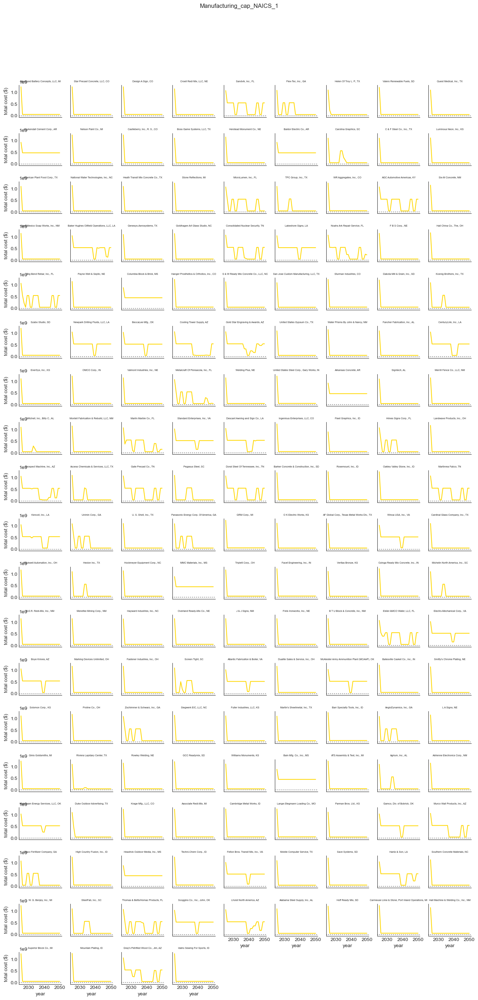

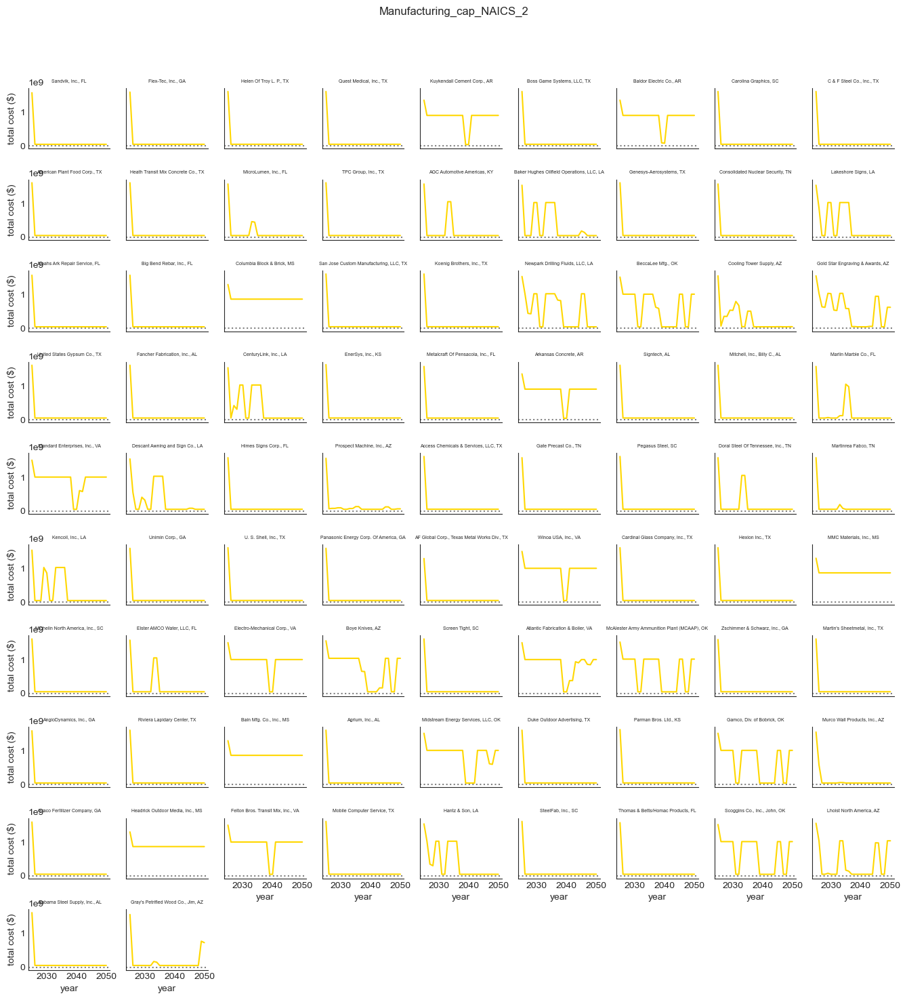

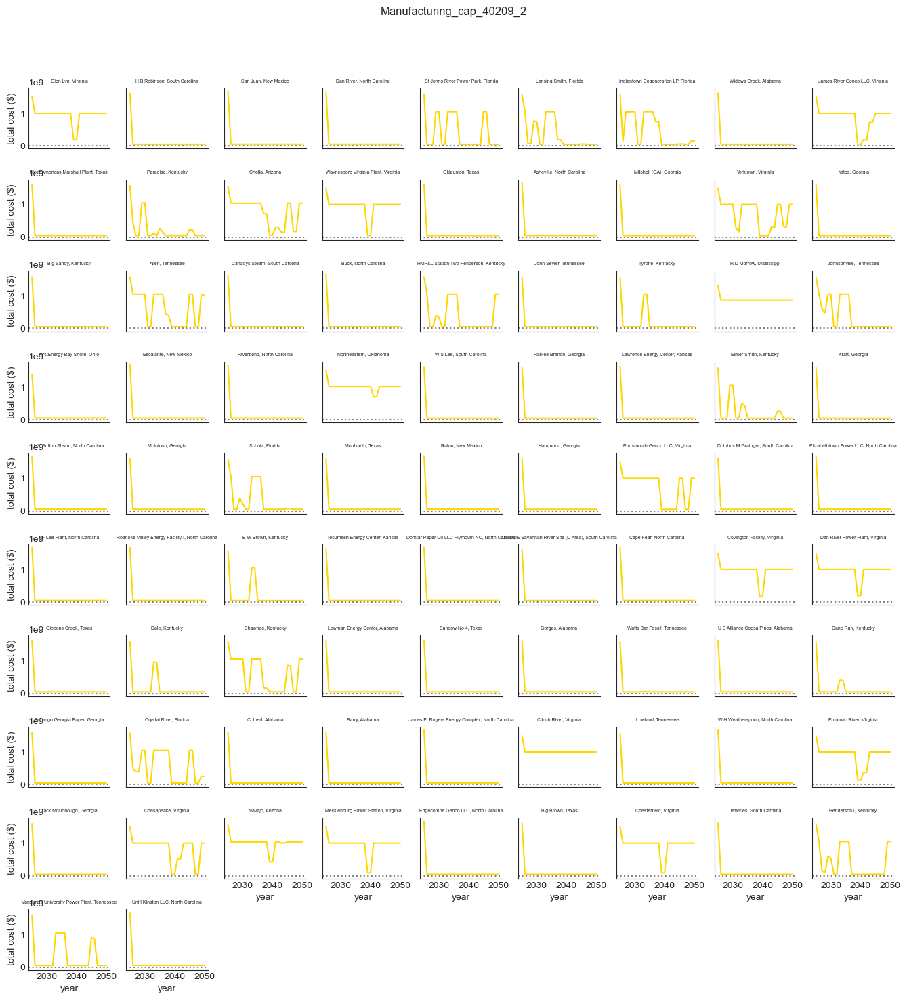

In [178]:
for files in manufacturing_files_cap:
# Initialize a grid of plots with an Axes for each walk
    grid = sns.FacetGrid(globals()['%s_plants' % (files)], col="location name",
                         col_wrap=9, height=1.5)

    # Draw a horizontal line to show the starting point
    grid.refline(y=0, linestyle=":")


    grid.map(plt.plot, "year", "total cost ($)", color='gold')

    # Adjust the tick positions, labels and 
    #sns.set(font_scale=0.1)
    grid.set_titles(row_template = '{row_name}', col_template = '{col_name}', size=5)

    grid.fig.tight_layout(w_pad=1)
    grid.fig.subplots_adjust(top=0.9)
    grid.fig.suptitle(f"{files}")


    plt.savefig(os.path.join(cwd, f"grid_before_update/grid_{files}_cap_totcost.png"));


#### Manufacturing Cost Utilization Factor

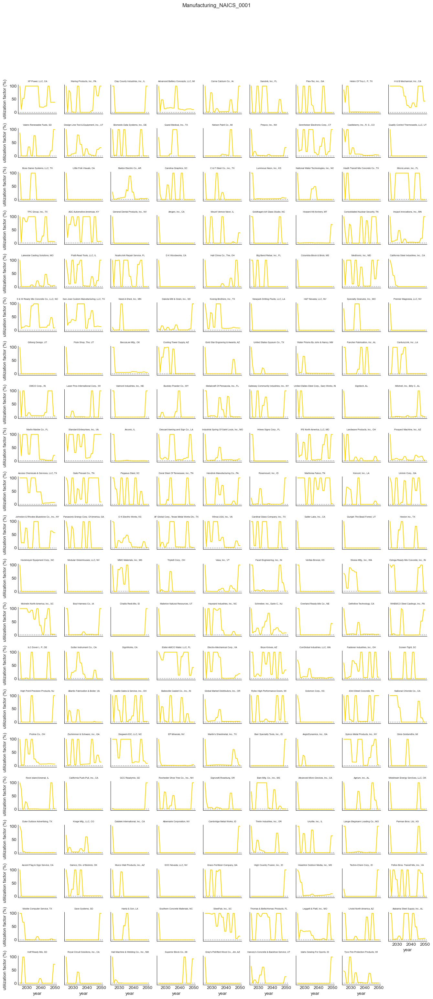

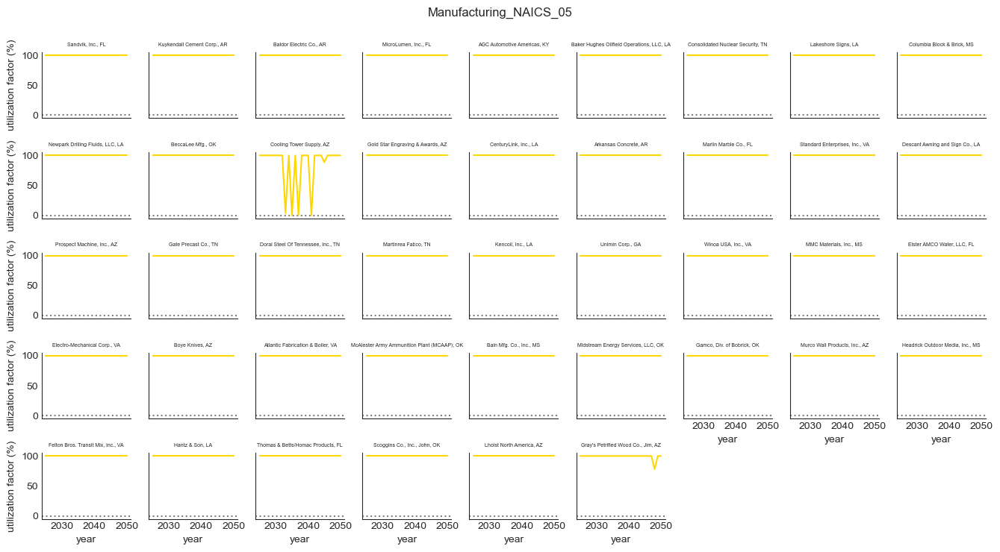

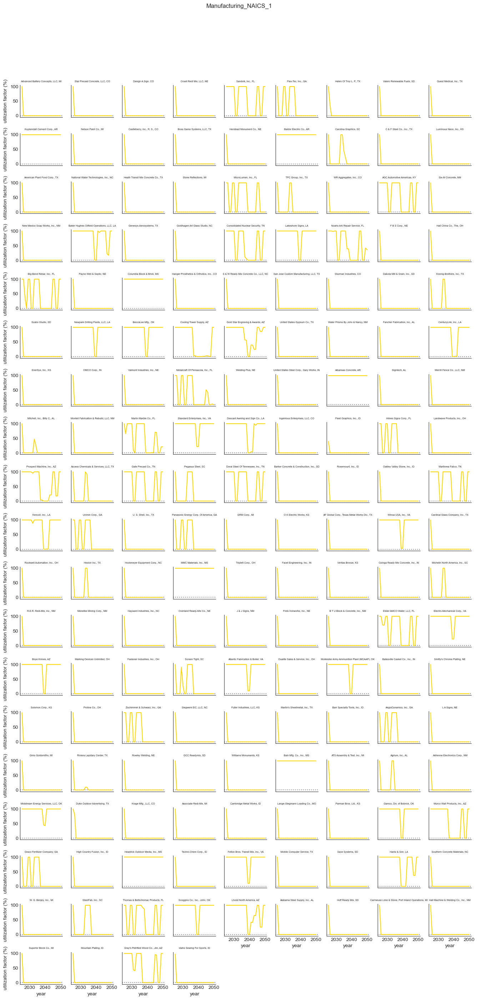

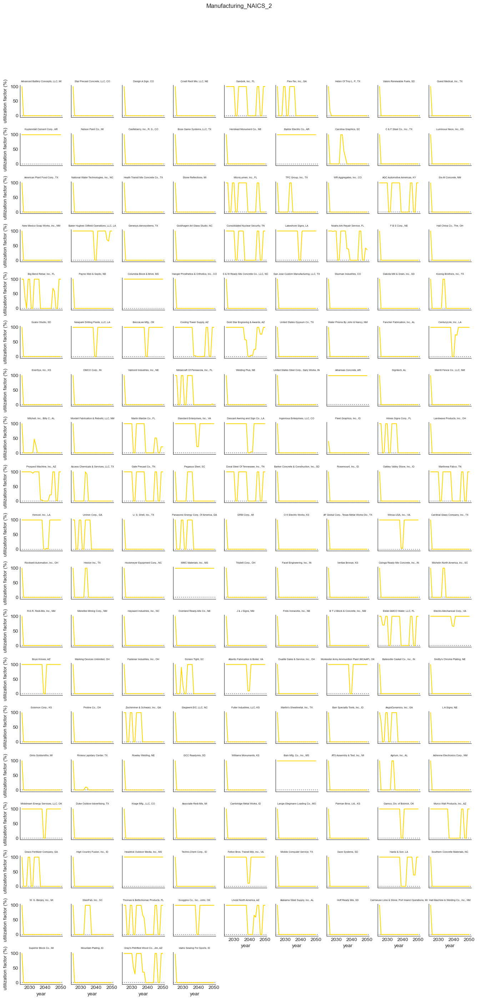

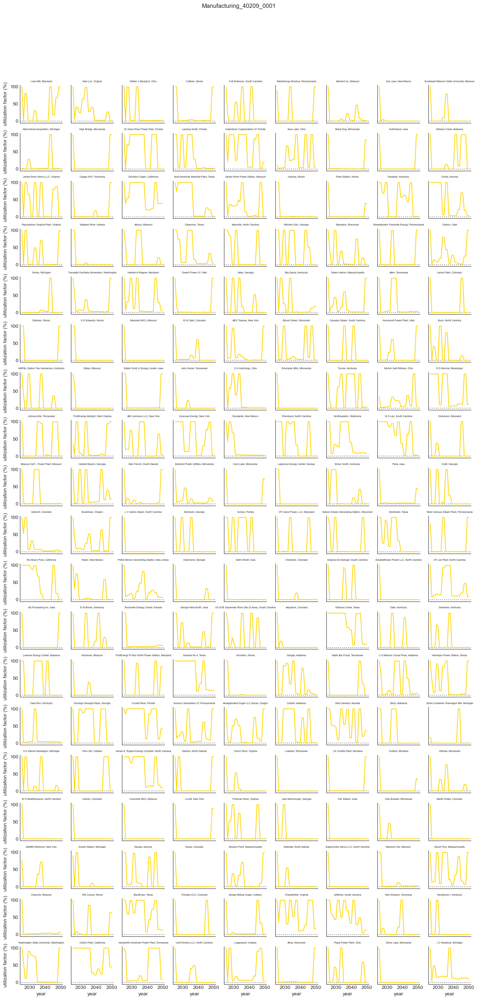

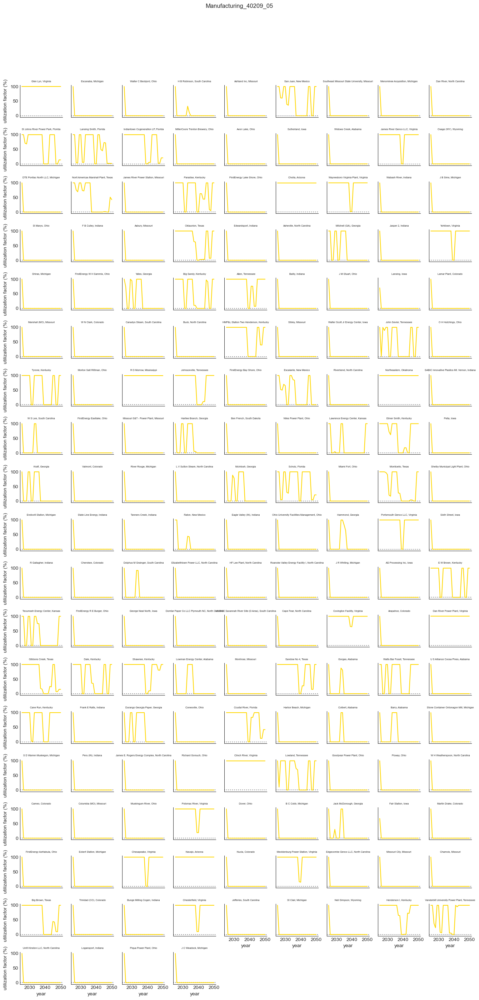

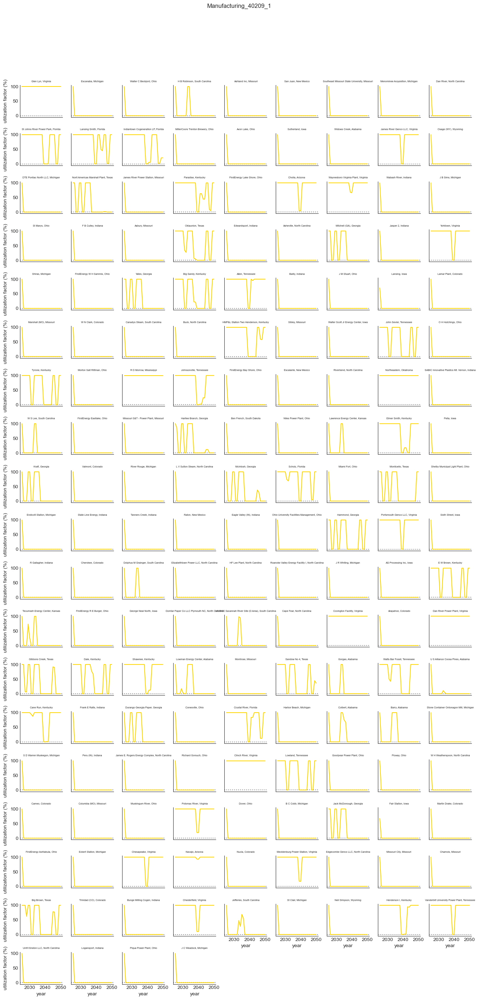

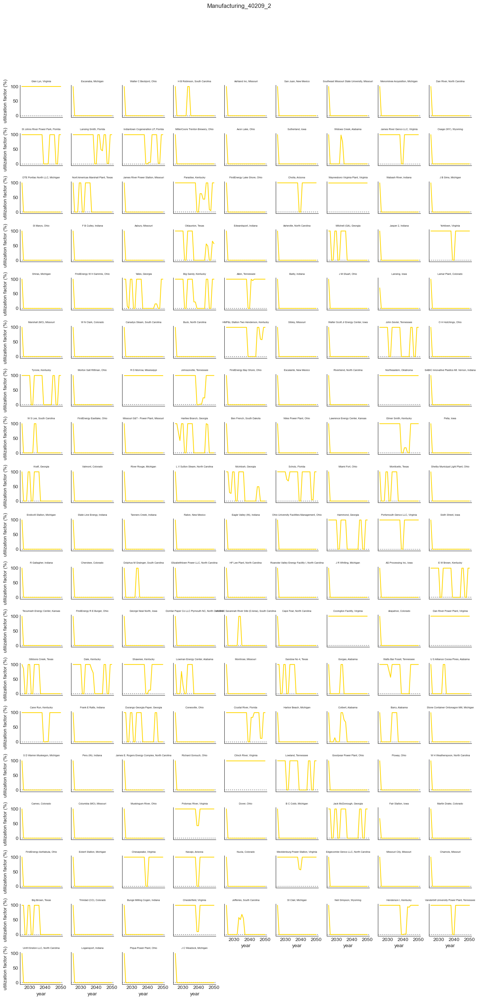

In [179]:
for files in manufacturing_files_cost:
# Initialize a grid of plots with an Axes for each walk
# Initialize a grid of plots with an Axes for each walk
    grid = sns.FacetGrid(globals()['%s_plants' % (files)], col="location name",
                         col_wrap=9, height=1.5)

    # Draw a horizontal line to show the starting point
    grid.refline(y=0, linestyle=":")


    grid.map(plt.plot, "year", "utilization factor (%)", color='gold')

    # Adjust the tick positions, labels and 
    #sns.set(font_scale=0.1)
    grid.set_titles(row_template = '{row_name}', col_template = '{col_name}', size=5)

    grid.fig.tight_layout(w_pad=1)
    grid.fig.subplots_adjust(top=0.9)
    grid.fig.suptitle(f"{files}")


    plt.savefig(os.path.join(cwd, f"grid_before_update/grid_{files}_cost_uf.png"));


#### Manufacturing Cost Total Cost

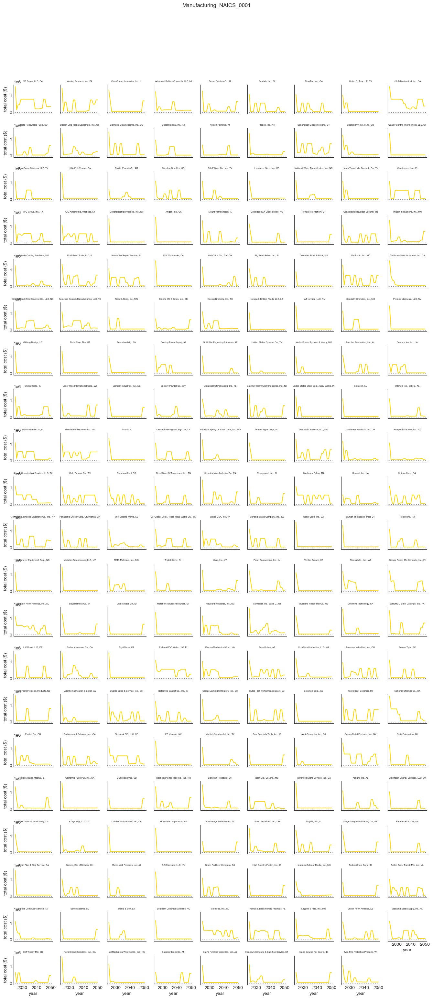

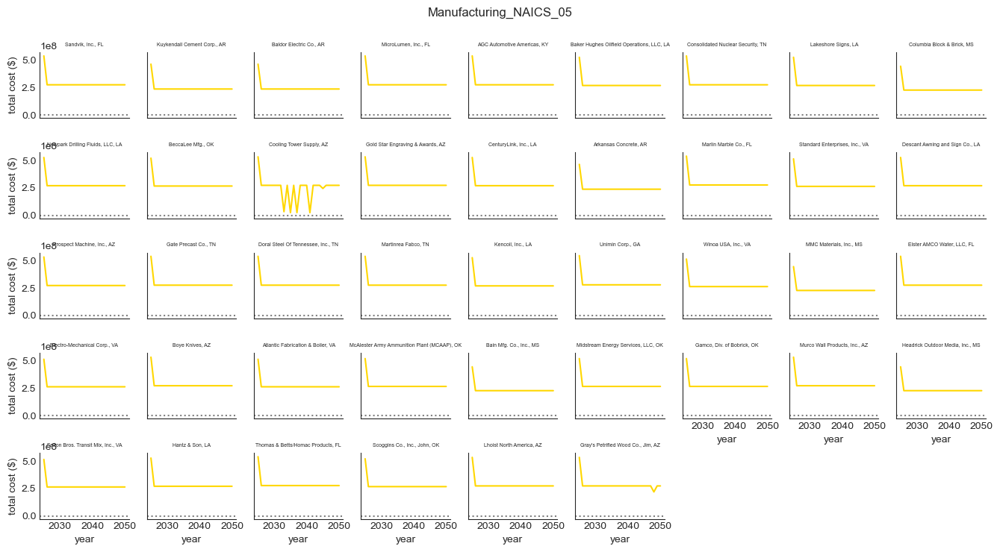

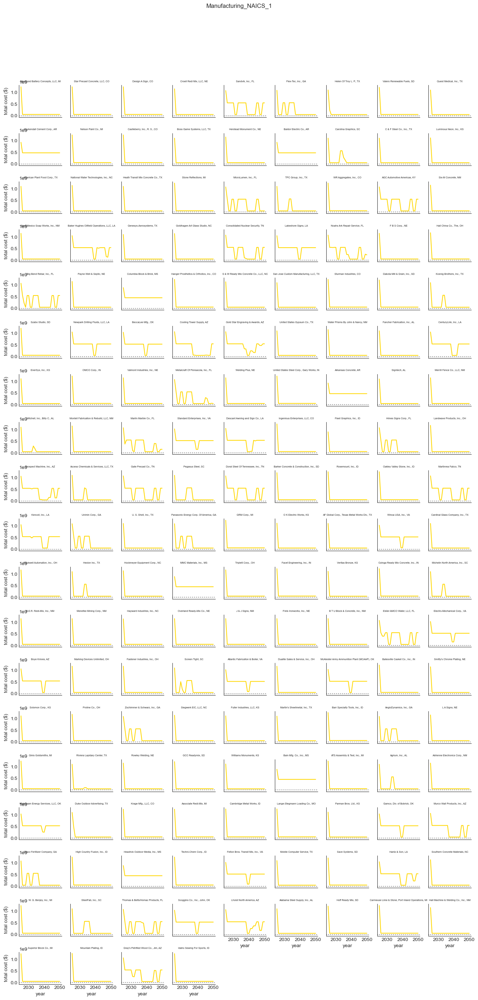

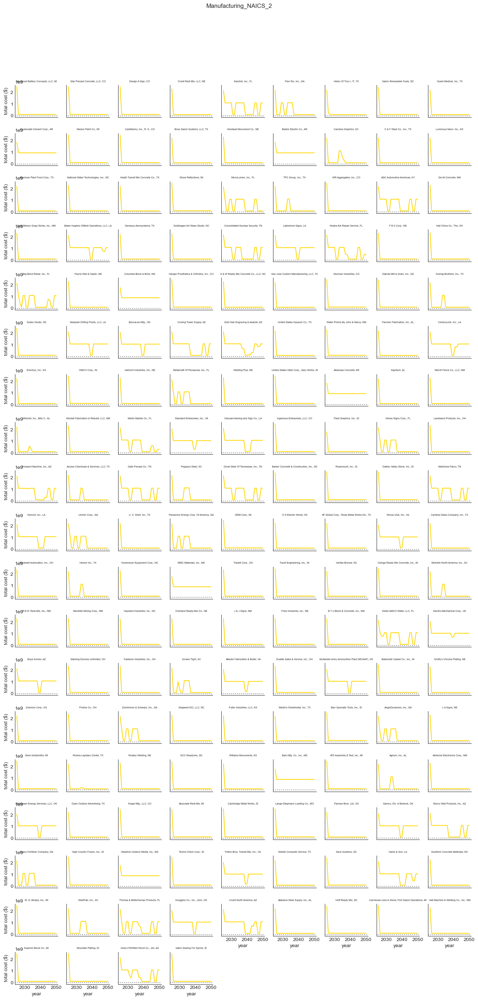

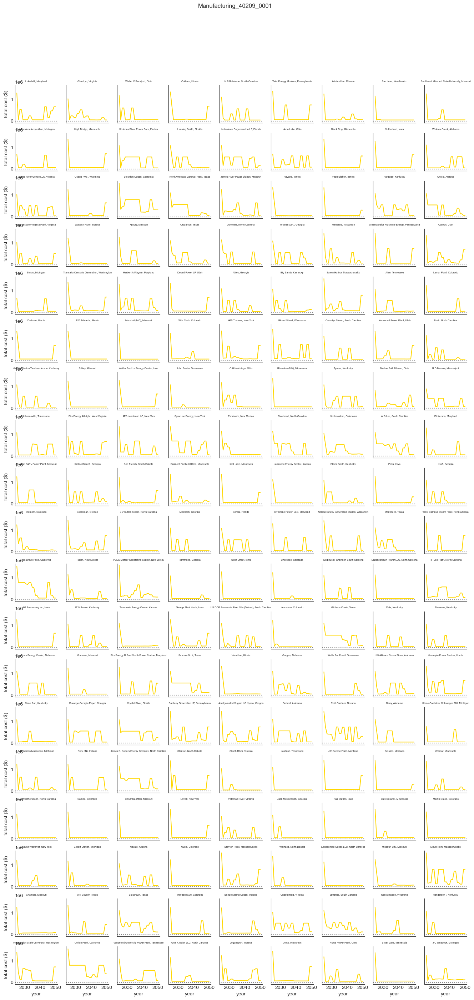

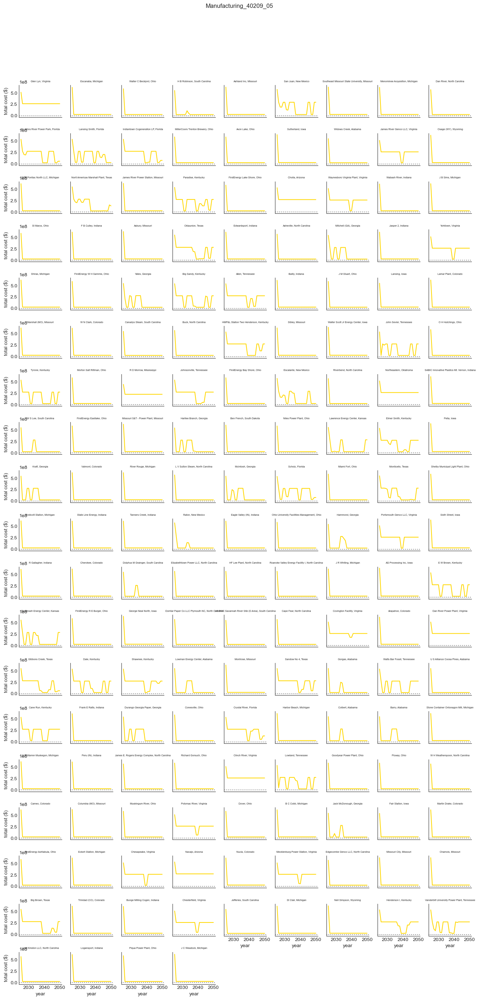

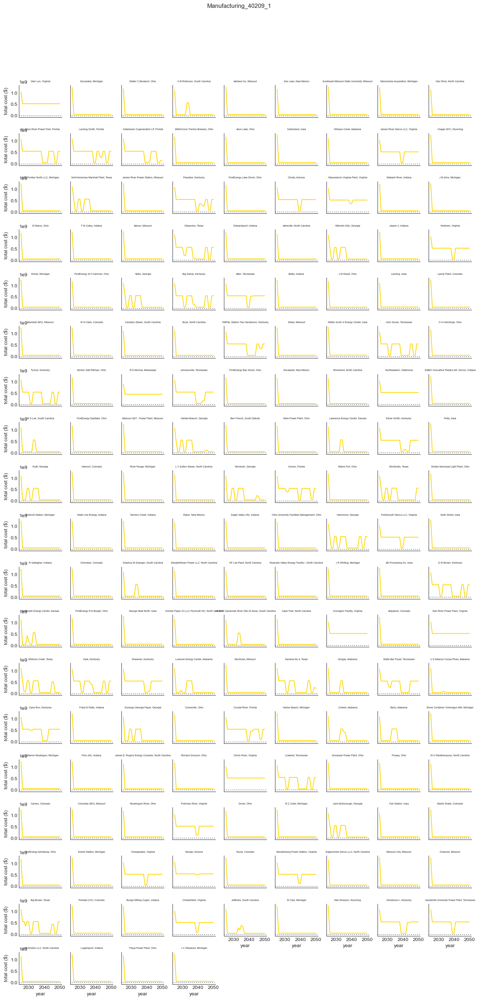

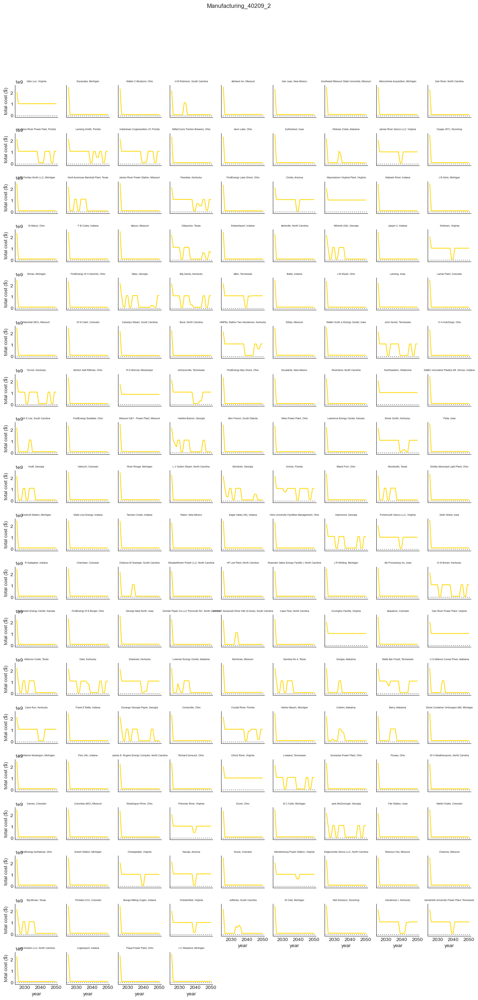

In [180]:
for files in manufacturing_files_cost:
# Initialize a grid of plots with an Axes for each walk
    grid = sns.FacetGrid(globals()['%s_plants' % (files)], col="location name",
                         col_wrap=9, height=1.5)

    # Draw a horizontal line to show the starting point
    grid.refline(y=0, linestyle=":")


    grid.map(plt.plot, "year", "total cost ($)", color='gold')

    # Adjust the tick positions, labels and 
    #sns.set(font_scale=0.1)
    grid.set_titles(row_template = '{row_name}', col_template = '{col_name}', size=5)

    grid.fig.tight_layout(w_pad=1)
    grid.fig.subplots_adjust(top=0.9)
    grid.fig.suptitle(f"{files}")


    plt.savefig(os.path.join(cwd, f"grid_before_update/grid_{files}_cost_totcost.png"));


### Map plots

USA map [source2](https://esri.maps.arcgis.com/home/item.html?id=8c2d6d7df8fa4142b0a1211c8dd66903).

In [29]:
import fiona
import geopandas as gp
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib import collections
import matplotlib.pyplot as plt
from shapely.geometry import LineString, Point, Polygon

%matplotlib inline

#### Load transportation files

##### Recycling cost

In [35]:
for files in recycling_files_cost:
    testfile_path = glob.glob(os.path.join(cwd, "scenarios_before_update", files, 'transportation.csv'))[0]
    globals()['%s_transportation' % (files)] = pd.read_csv(testfile_path) 
    globals()['%s_transportation' % (files)] = globals()['%s_transportation' % (files)].replace({"year": years_dict})

##### Recycling capacity

In [36]:
for files in recycling_files_cap:
    testfile_path = glob.glob(os.path.join(cwd, "scenarios_before_update", files, 'transportation.csv'))[0]
    globals()['%s_transportation' % (files)] = pd.read_csv(testfile_path) 
    globals()['%s_transportation' % (files)] = globals()['%s_transportation' % (files)].replace({"year": years_dict})

##### Manufacturing cost

In [37]:
for files in manufacturing_files_cost:
    testfile_path = glob.glob(os.path.join(cwd, "scenarios_before_update", files, 'transportation.csv'))[0]
    globals()['%s_transportation' % (files)] = pd.read_csv(testfile_path) 
    globals()['%s_transportation' % (files)] = globals()['%s_transportation' % (files)].replace({"year": years_dict})

##### Manufacturing capacity

In [38]:
for files in manufacturing_files_cap:
    testfile_path = glob.glob(os.path.join(cwd, "scenarios_before_update", files, 'transportation.csv'))[0]
    globals()['%s_transportation' % (files)] = pd.read_csv(testfile_path) 
    globals()['%s_transportation' % (files)] = globals()['%s_transportation' % (files)].replace({"year": years_dict})

#### Recycling cost maps

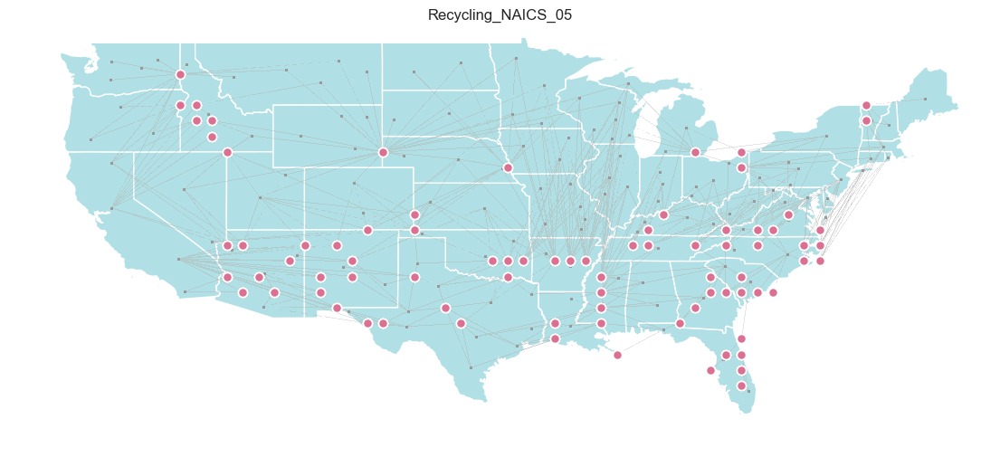

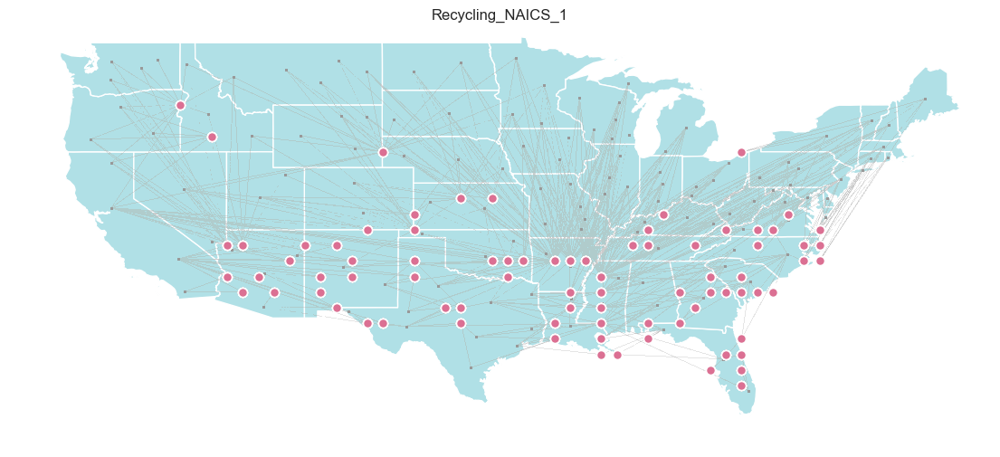

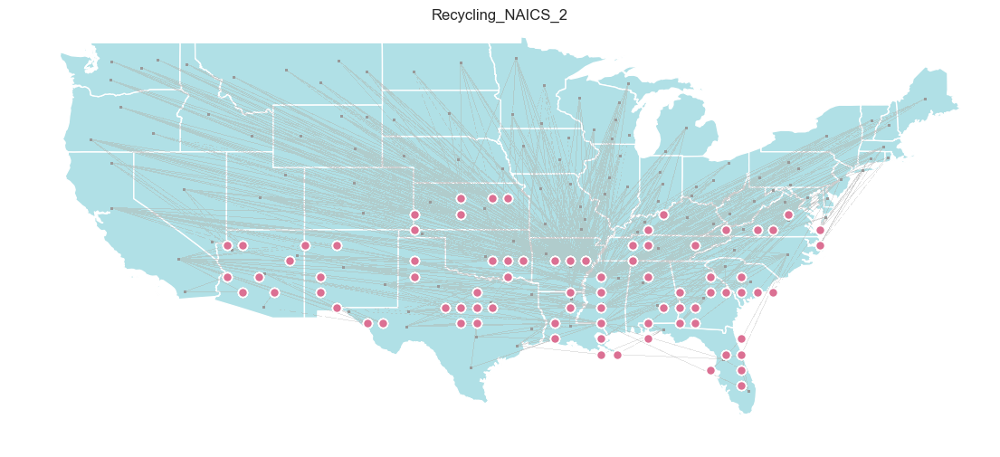

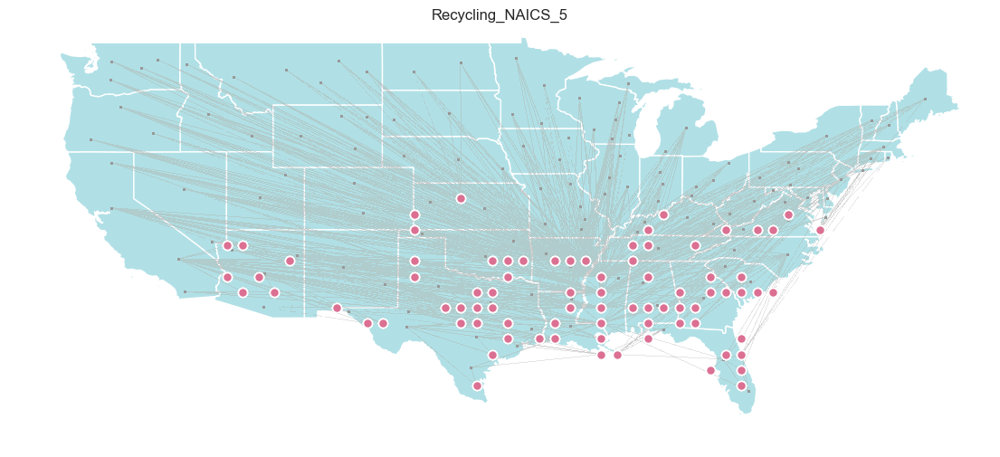

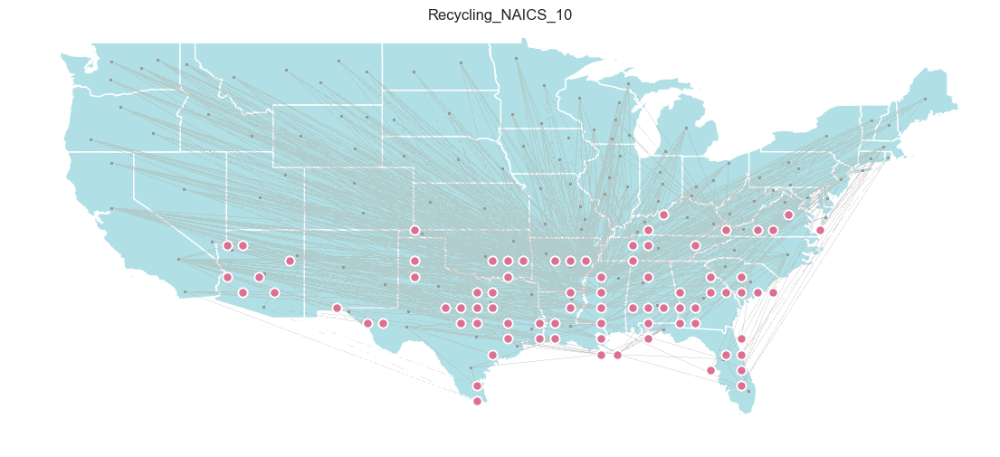

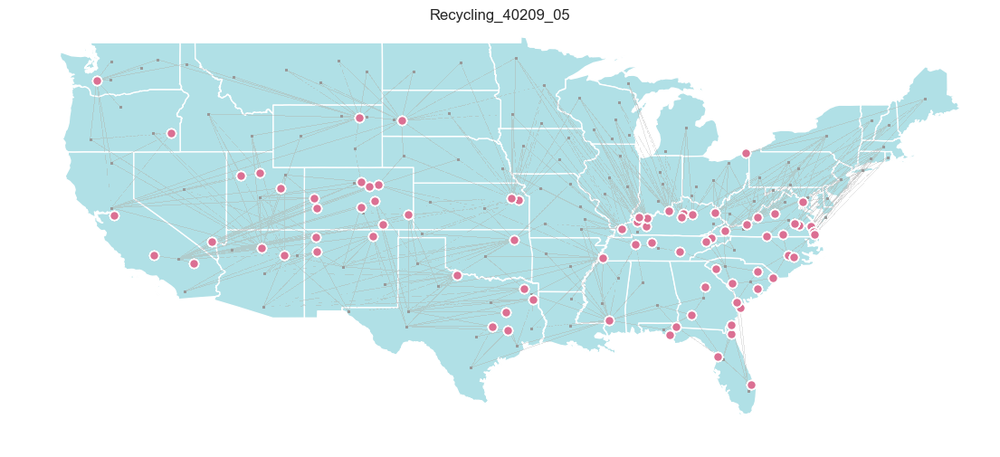

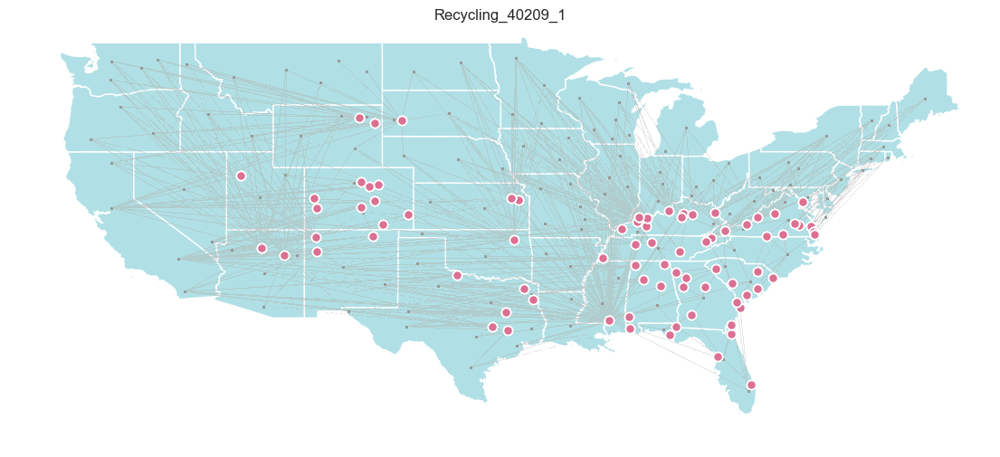

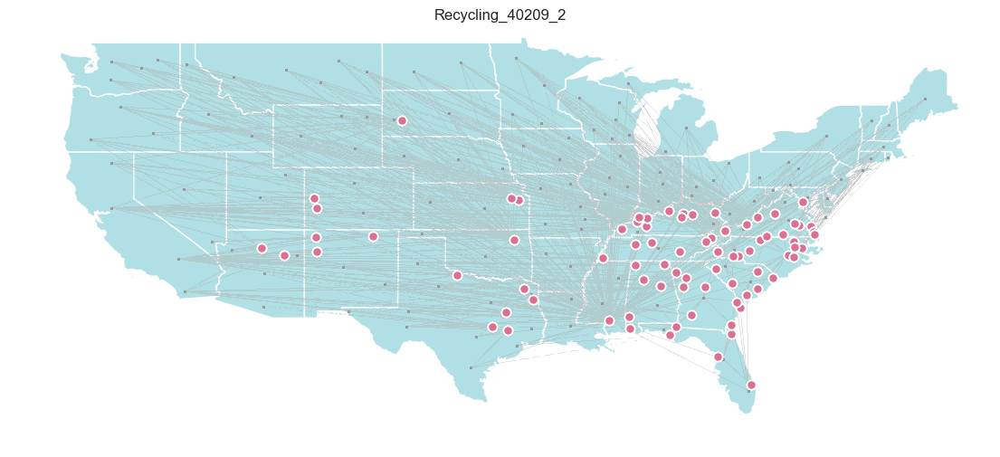

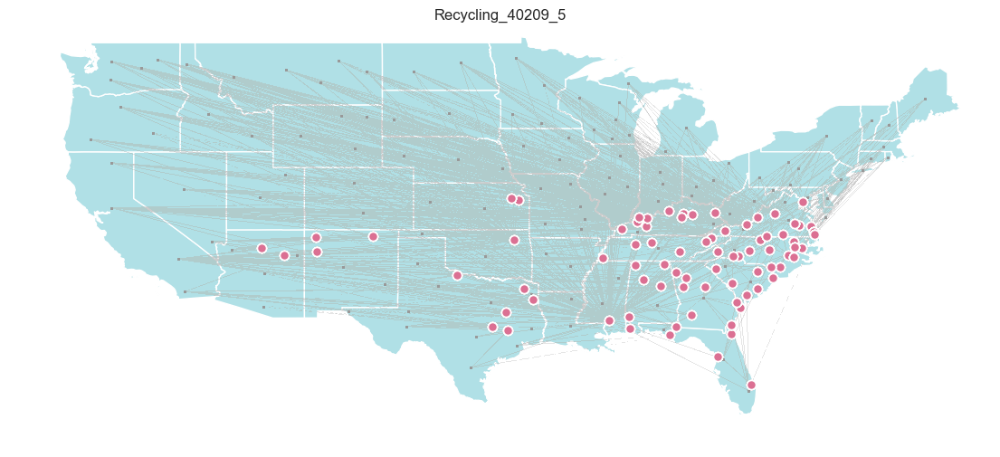

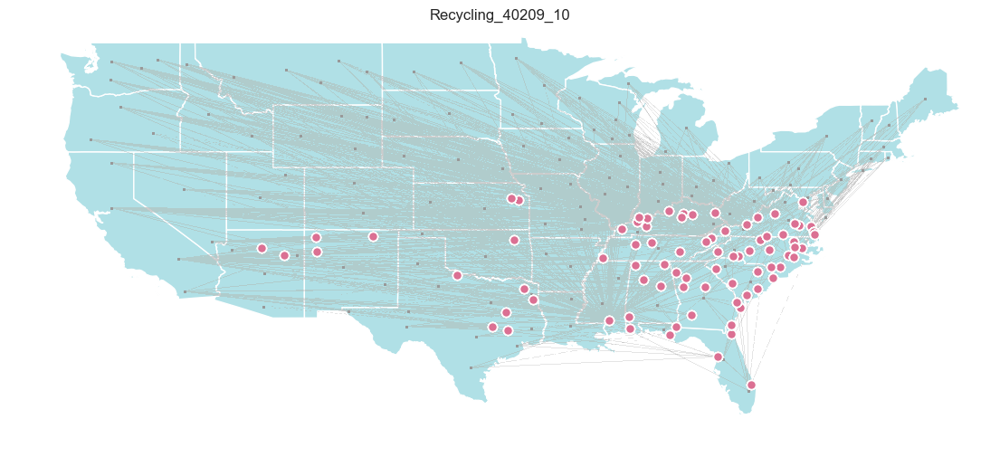

In [118]:
for files in recycling_files_cost:    
    # Plot base map
    world = gp.read_file(os.path.join(f'resources','USA_States_(Generalized)', 'USA_States_Generalized.shp'))
    world = world.to_crs("EPSG:4326")
    ax = world.plot(color="powderblue", edgecolor="1", figsize=(14, 7))
    ax.set_ylim([23, 50])
    ax.set_xlim([-128, -65])
    plt.axis('off')
    ax.set(title=f'{files}')
    # Draw transportation lines
    data = globals()['%s_transportation' % (files)]
    lines = [
        [
            (
                row["source longitude (deg)"],
                row["source latitude (deg)"],
            ),
            (
                row["destination longitude (deg)"],
                row["destination latitude (deg)"],
            ),
        ]
        for (index, row) in data.iterrows()
    ]
    ax.add_collection(
        collections.LineCollection(
            lines,
            linewidths=0.005,
            zorder=1,
            alpha=0.3,
            color="0.8",
        )
    )

    # Draw source points
    points = gp.points_from_xy(
        data["source longitude (deg)"],
        data["source latitude (deg)"],
    )
    gp.GeoDataFrame(data, geometry=points).plot(ax=ax, color="0.6", markersize=1)

    # Draw destination points
    points = gp.points_from_xy(
        data["destination longitude (deg)"],
        data["destination latitude (deg)"],
    )
    gp.GeoDataFrame(data, geometry=points).plot(ax=ax, markersize=50, color="palevioletred", edgecolor='white')
    
    plt.savefig(os.path.join("maps_before_update",f"map_{files}_cost.png"), dpi=300);
    plt.savefig(os.path.join("maps_before_update",f"map_{files}_cost.pdf"), dpi=300);

#### Recycling capacity maps

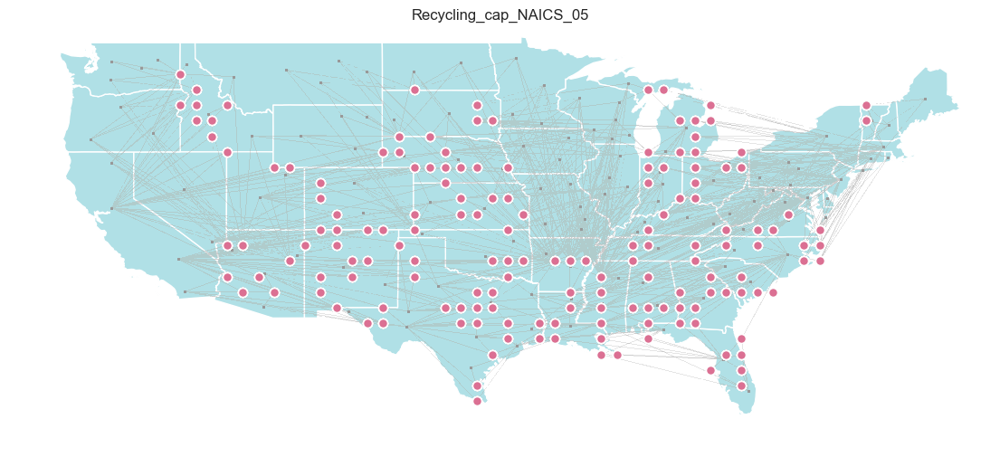

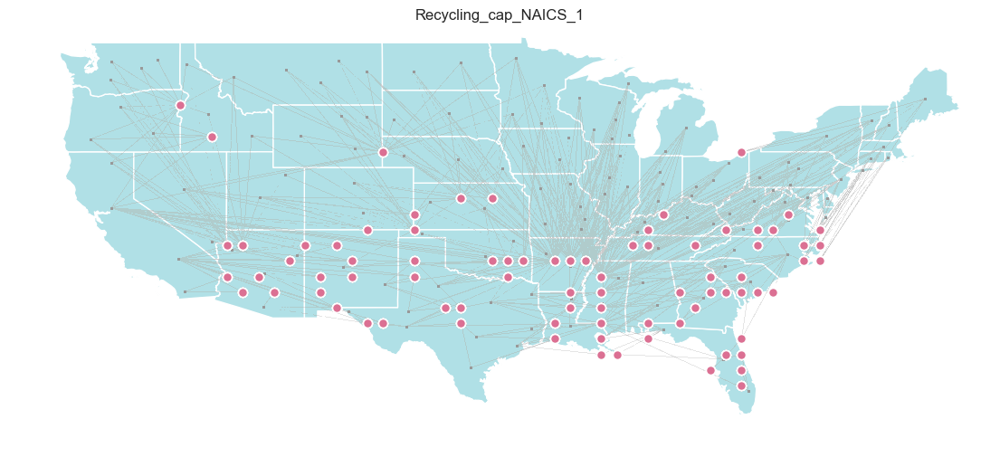

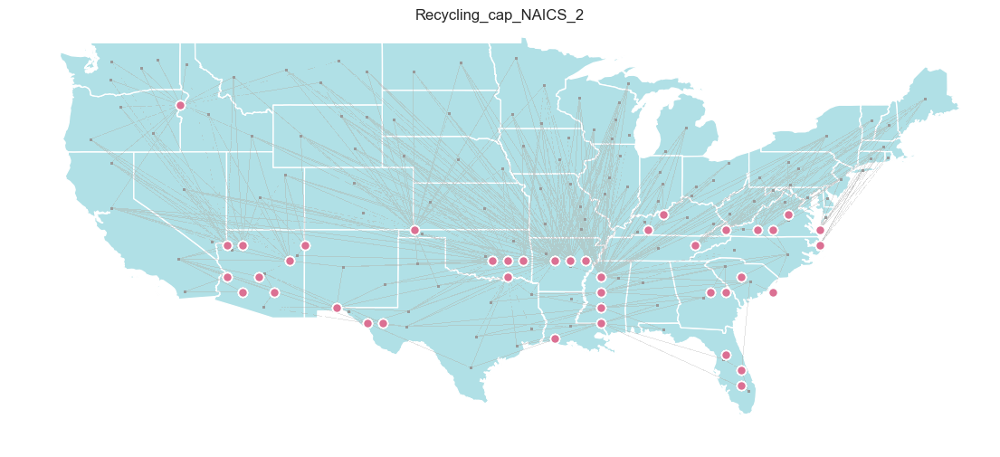

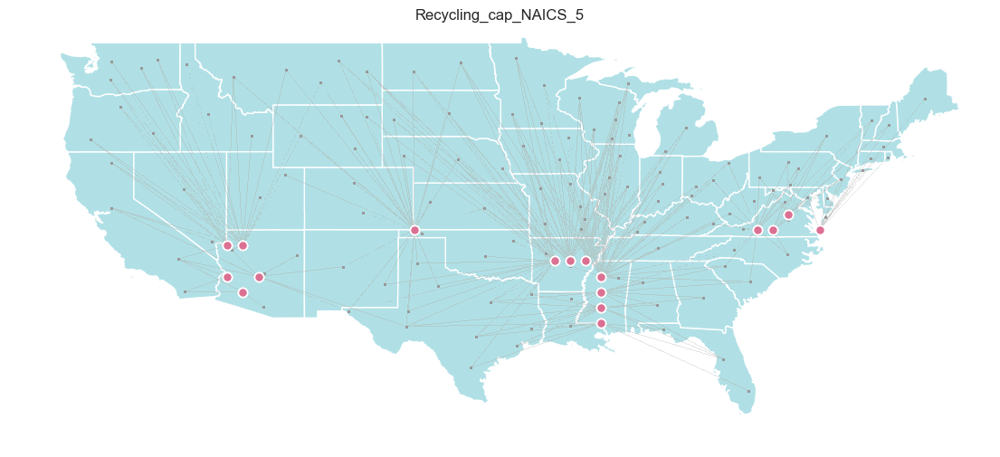

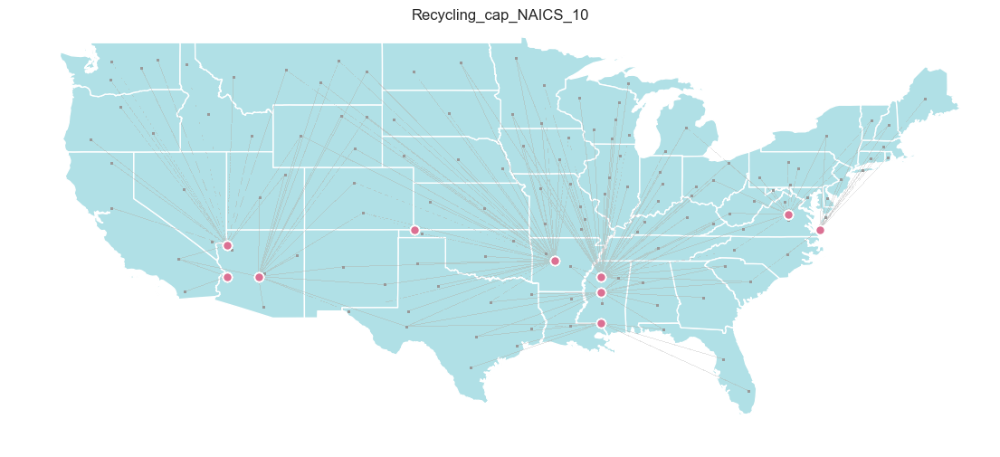

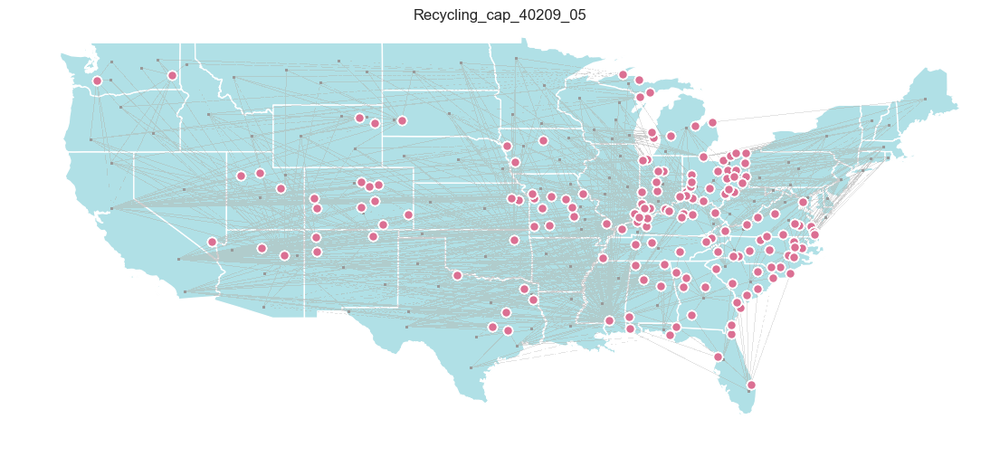

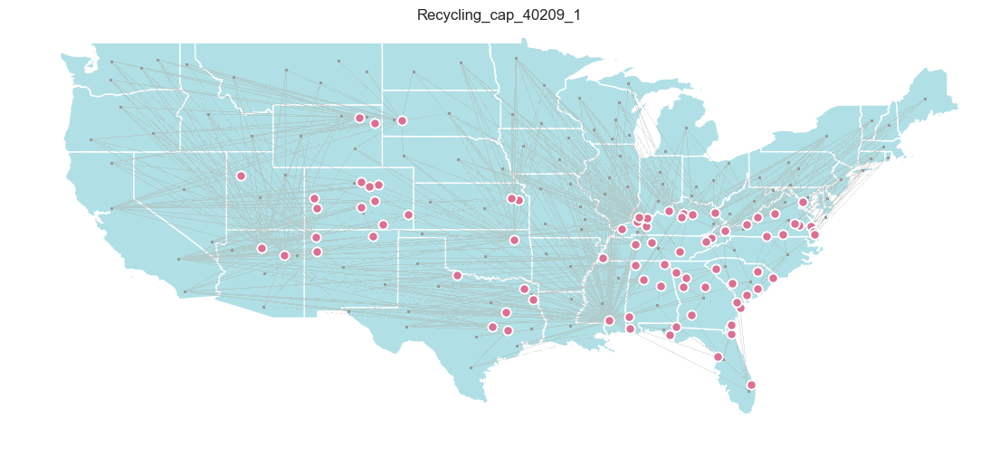

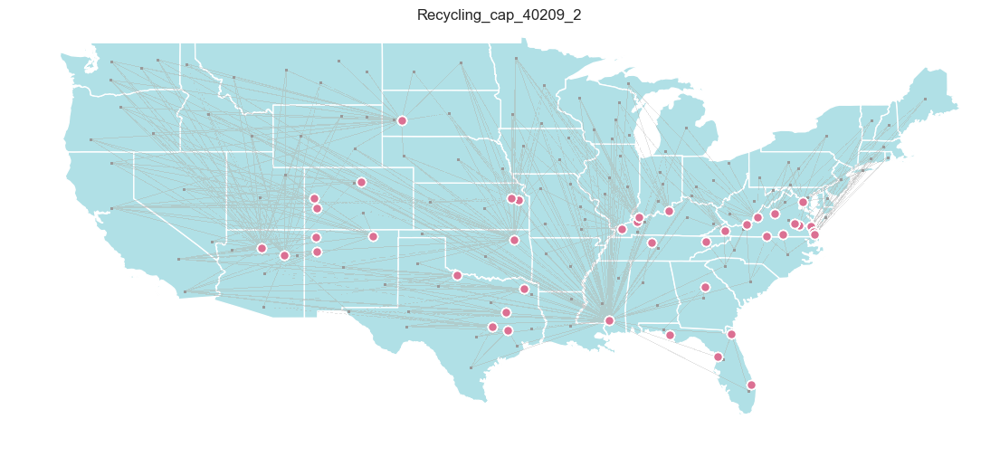

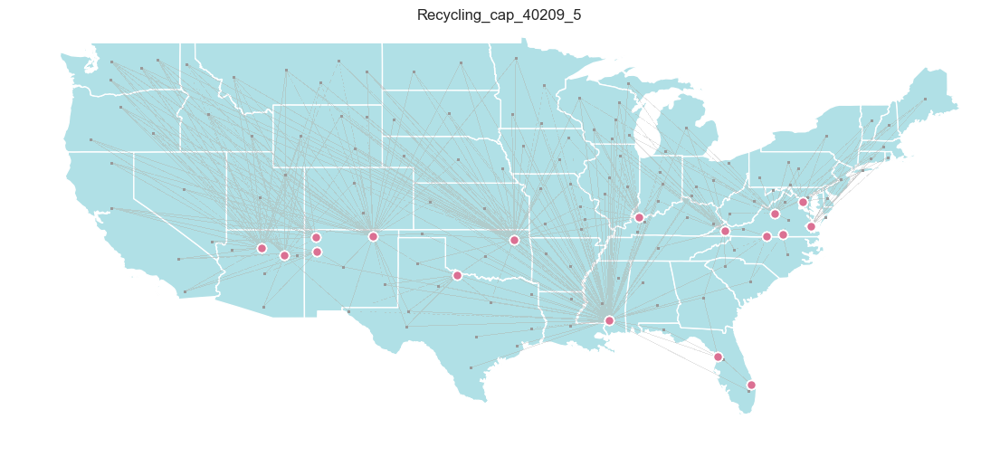

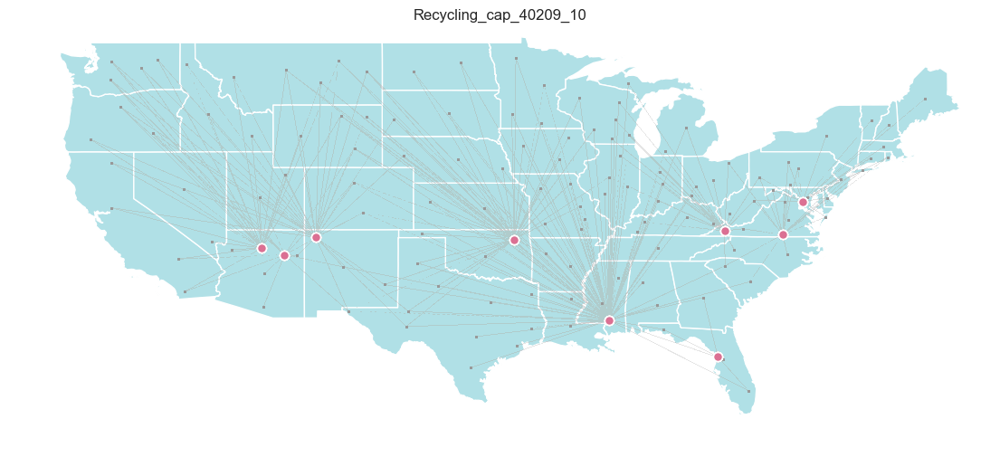

In [119]:
for files in recycling_files_cap:    
    # Plot base map
    world = gp.read_file(os.path.join(f'resources','USA_States_(Generalized)', 'USA_States_Generalized.shp'))
    world = world.to_crs("EPSG:4326")
    ax = world.plot(color="powderblue", edgecolor="1", figsize=(14, 7))
    ax.set_ylim([23, 50])
    ax.set_xlim([-128, -65])
    plt.axis('off')
    ax.set(title=f'{files}')
    # Draw transportation lines
    data = globals()['%s_transportation' % (files)]
    lines = [
        [
            (
                row["source longitude (deg)"],
                row["source latitude (deg)"],
            ),
            (
                row["destination longitude (deg)"],
                row["destination latitude (deg)"],
            ),
        ]
        for (index, row) in data.iterrows()
    ]
    ax.add_collection(
        collections.LineCollection(
            lines,
            linewidths=0.005,
            zorder=1,
            alpha=0.3,
            color="0.8",
        )
    )

    # Draw source points
    points = gp.points_from_xy(
        data["source longitude (deg)"],
        data["source latitude (deg)"],
    )
    gp.GeoDataFrame(data, geometry=points).plot(ax=ax, color="0.6", markersize=1)

    # Draw destination points
    points = gp.points_from_xy(
        data["destination longitude (deg)"],
        data["destination latitude (deg)"],
    )
    gp.GeoDataFrame(data, geometry=points).plot(ax=ax, markersize=50, color="palevioletred", edgecolor='white')
    
    plt.savefig(os.path.join("maps_before_update",f"map_{files}_cap.png"), dpi=300);
    plt.savefig(os.path.join("maps_before_update",f"map_{files}_cap.pdf"), dpi=300);

#### Manufacturing cost maps

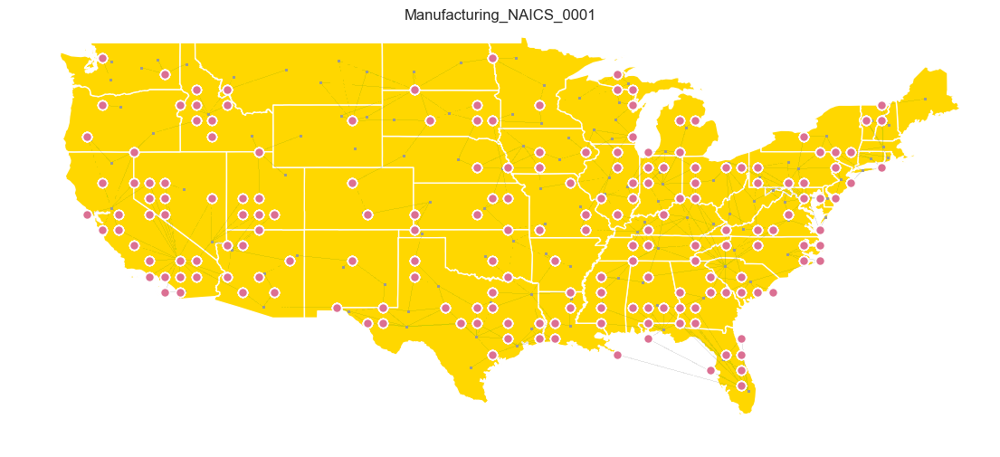

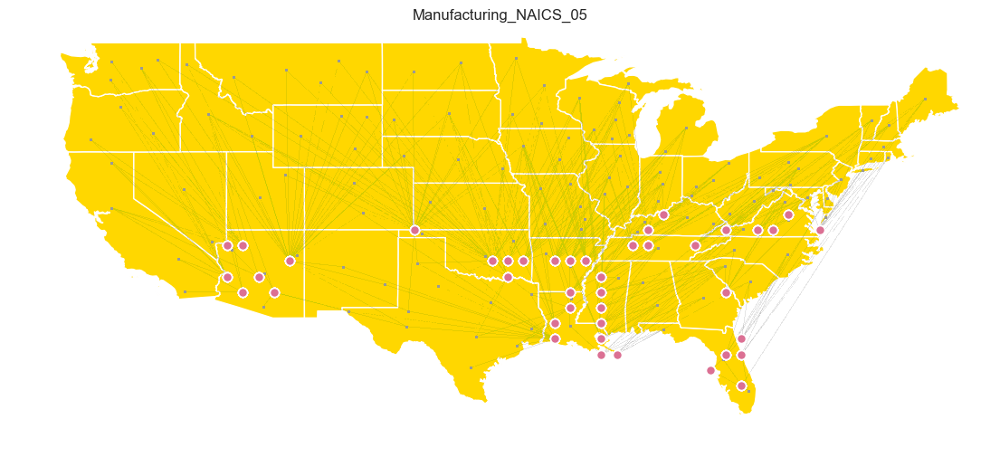

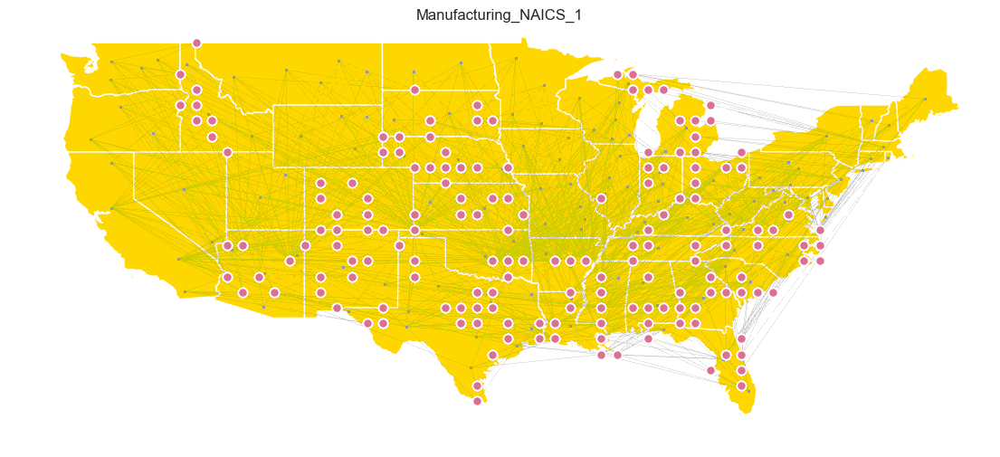

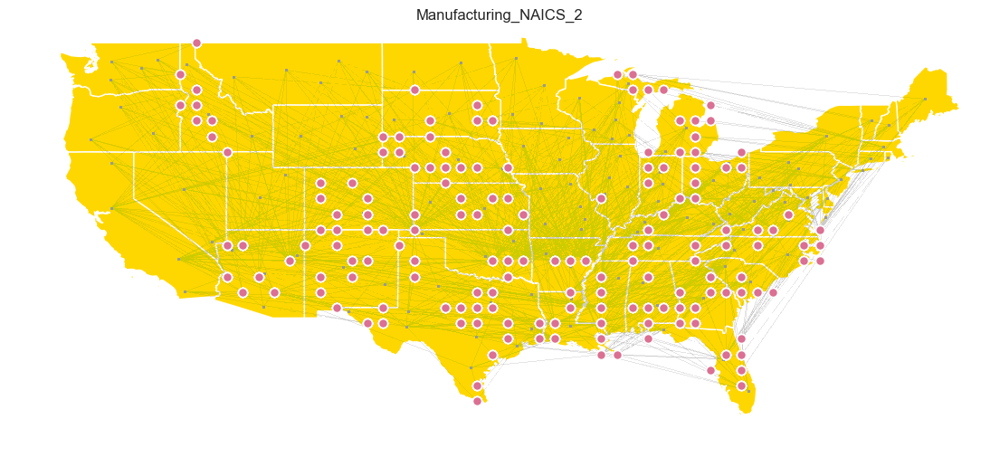

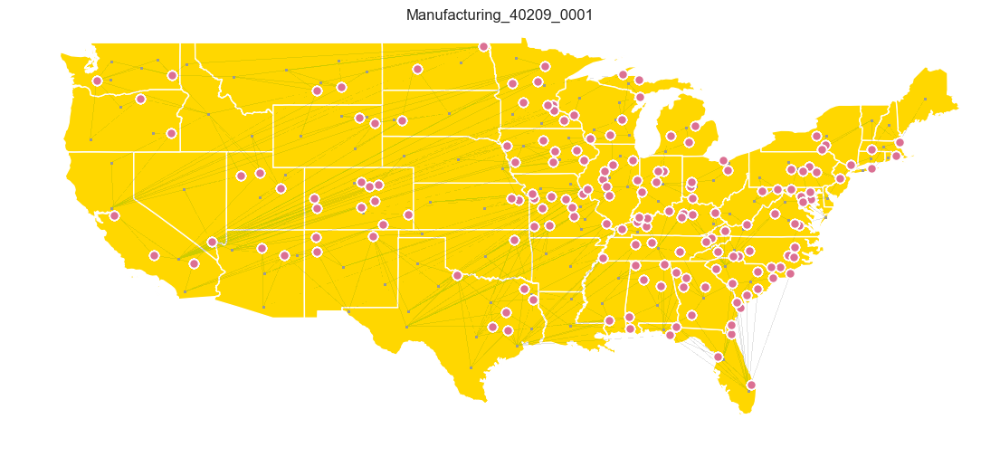

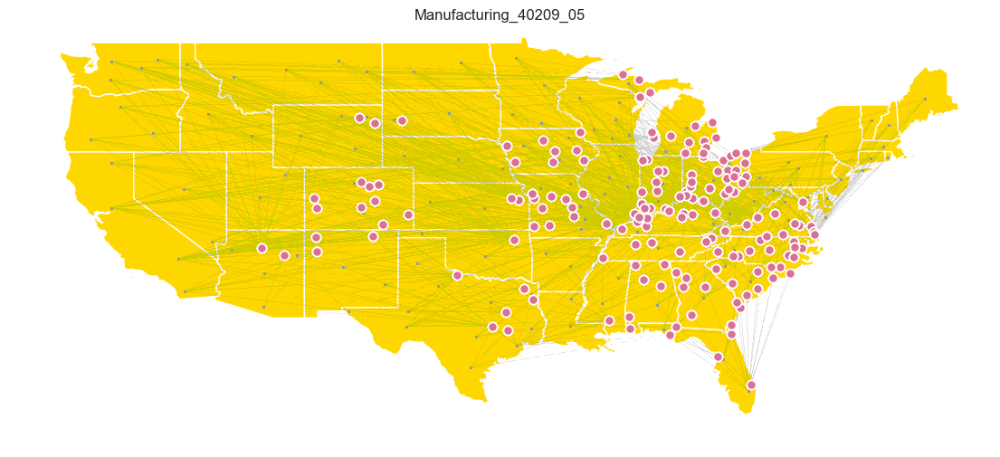

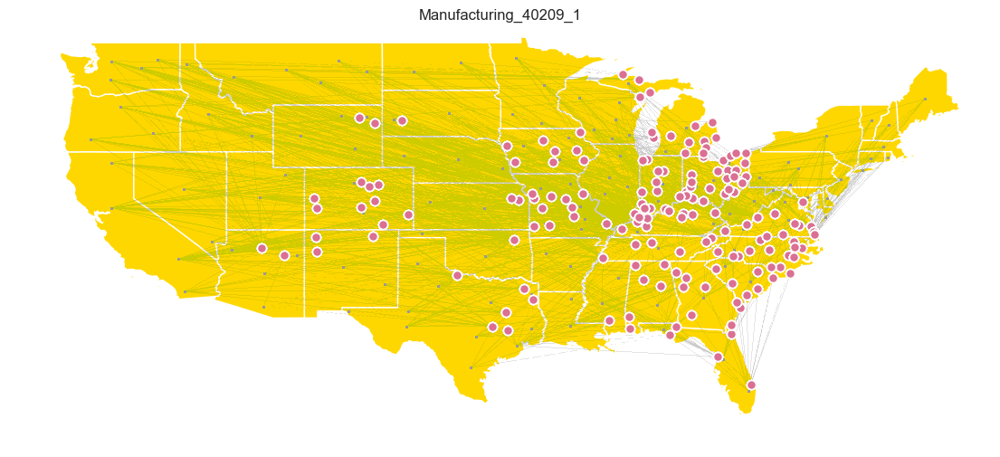

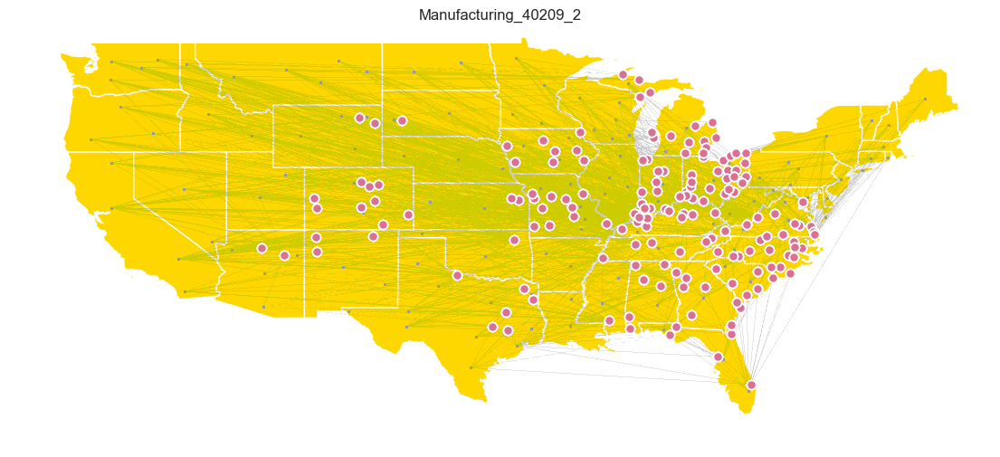

In [125]:
for files in manufacturing_files_cost:    
    # Plot base map
    world = gp.read_file(os.path.join(f'resources','USA_States_(Generalized)', 'USA_States_Generalized.shp'))
    world = world.to_crs("EPSG:4326")
    ax = world.plot(color="gold", edgecolor="1", figsize=(14, 7))
    ax.set_ylim([23, 50])
    ax.set_xlim([-128, -65])
    plt.axis('off')
    ax.set(title=f'{files}')
    # Draw transportation lines
    data = globals()['%s_transportation' % (files)]
    lines = [
        [
            (
                row["source longitude (deg)"],
                row["source latitude (deg)"],
            ),
            (
                row["destination longitude (deg)"],
                row["destination latitude (deg)"],
            ),
        ]
        for (index, row) in data.iterrows()
    ]
    ax.add_collection(
        collections.LineCollection(
            lines,
            linewidths=0.005,
            zorder=1,
            alpha=0.3,
            color="0.8",
        )
    )

    # Draw source points
    points = gp.points_from_xy(
        data["source longitude (deg)"],
        data["source latitude (deg)"],
    )
    gp.GeoDataFrame(data, geometry=points).plot(ax=ax, color="0.6", markersize=1)

    # Draw destination points
    points = gp.points_from_xy(
        data["destination longitude (deg)"],
        data["destination latitude (deg)"],
    )
    gp.GeoDataFrame(data, geometry=points).plot(ax=ax, markersize=50, color="palevioletred", edgecolor='white')
    
    plt.savefig(os.path.join("maps_before_update",f"map_{files}_cost.png"), dpi=300);
    plt.savefig(os.path.join("maps_before_update",f"map_{files}_cost.pdf"), dpi=300);

#### Manufacturing capacity maps

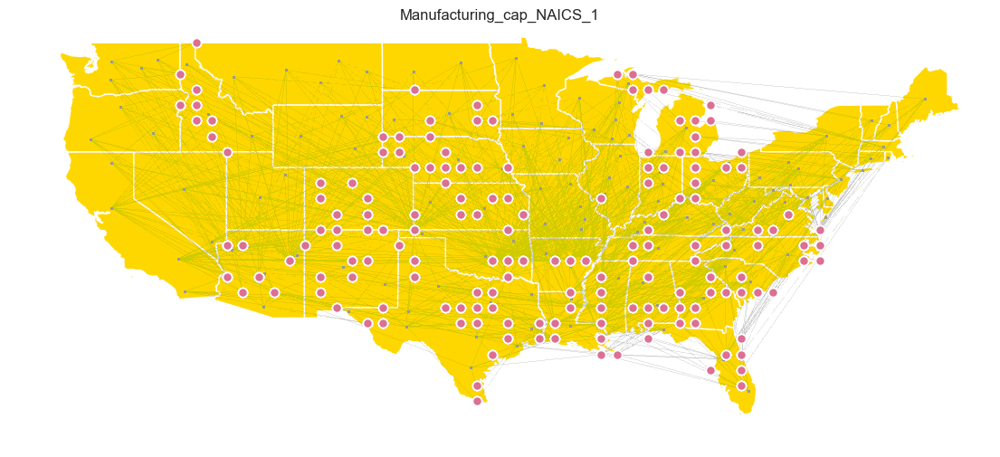

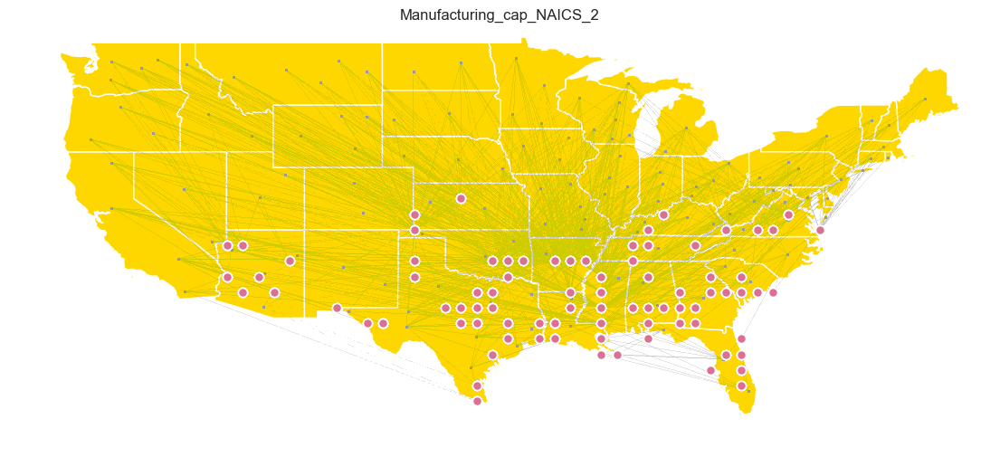

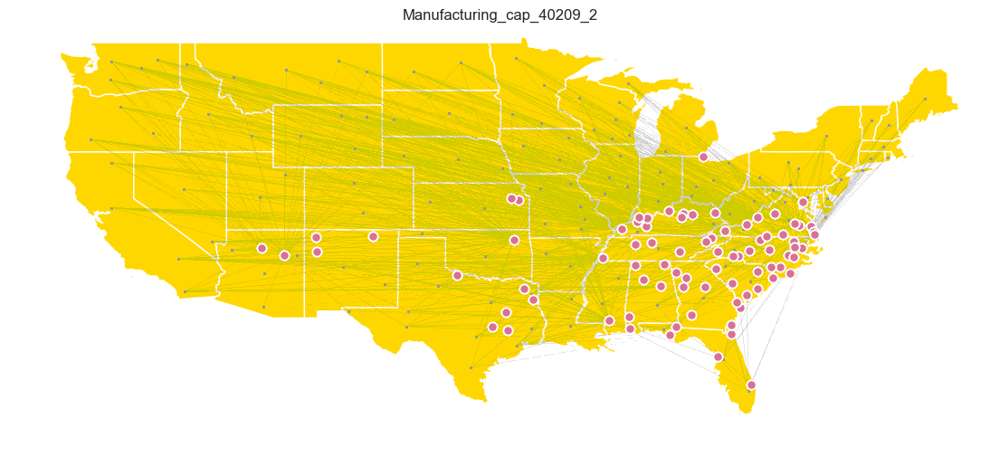

In [126]:
for files in manufacturing_files_cap:    
    # Plot base map
    world = gp.read_file(os.path.join(f'resources','USA_States_(Generalized)', 'USA_States_Generalized.shp'))
    world = world.to_crs("EPSG:4326")
    ax = world.plot(color="gold", edgecolor="1", figsize=(14, 7))
    ax.set_ylim([23, 50])
    ax.set_xlim([-128, -65])
    plt.axis('off')
    ax.set(title=f'{files}')
    # Draw transportation lines
    data = globals()['%s_transportation' % (files)]
    lines = [
        [
            (
                row["source longitude (deg)"],
                row["source latitude (deg)"],
            ),
            (
                row["destination longitude (deg)"],
                row["destination latitude (deg)"],
            ),
        ]
        for (index, row) in data.iterrows()
    ]
    ax.add_collection(
        collections.LineCollection(
            lines,
            linewidths=0.005,
            zorder=1,
            alpha=0.3,
            color="0.8",
        )
    )

    # Draw source points
    points = gp.points_from_xy(
        data["source longitude (deg)"],
        data["source latitude (deg)"],
    )
    gp.GeoDataFrame(data, geometry=points).plot(ax=ax, color="0.6", markersize=1)

    # Draw destination points
    points = gp.points_from_xy(
        data["destination longitude (deg)"],
        data["destination latitude (deg)"],
    )
    gp.GeoDataFrame(data, geometry=points).plot(ax=ax, markersize=50, color="palevioletred", edgecolor='white')
    
    plt.savefig(os.path.join("maps_before_update",f"map_{files}_cap.png"), dpi=300);
    plt.savefig(os.path.join("maps_before_update",f"map_{files}_cap.pdf"), dpi=300);

In [ ]:
# Plot base map
world = gp.read_file(os.path.join(f'resources','USA_States_(Generalized)', 'USA_States_Generalized.shp'))
world = world.to_crs("EPSG:4326")
ax = world.plot(color="gold", edgecolor="1", figsize=(14, 7))
ax.set_ylim([23, 50])
ax.set_xlim([-128, -65])
plt.axis('off')
ax.set(title=f'{files}')
# Draw transportation lines
data = globals()['%s_transportation' % (files)]
lines = [
    [
        (
            row["source longitude (deg)"],
            row["source latitude (deg)"],
        ),
        (
            row["destination longitude (deg)"],
            row["destination latitude (deg)"],
        ),
    ]
    for (index, row) in data.iterrows()
]
ax.add_collection(
    collections.LineCollection(
        lines,
        linewidths=0.005,
        zorder=1,
        alpha=0.3,
        color="0.8",
    )
)

# Draw source points
points = gp.points_from_xy(
    data["source longitude (deg)"],
    data["source latitude (deg)"],
)
gp.GeoDataFrame(data, geometry=points).plot(ax=ax, color="0.6", markersize=1)

# Draw destination points
points = gp.points_from_xy(
    data["destination longitude (deg)"],
    data["destination latitude (deg)"],
)
gp.GeoDataFrame(data, geometry=points).plot(ax=ax, markersize=50, color="palevioletred", edgecolor='white')


(-128.0, -65.0, 23.0, 50.0)

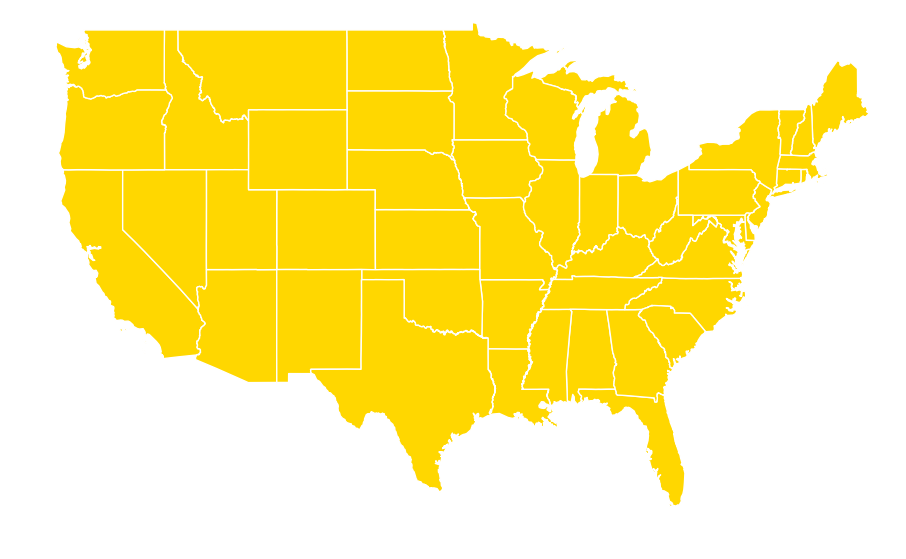

In [142]:
world = gp.read_file(os.path.join(f'resources','USA_States_(Generalized)', 'USA_States_Generalized.shp'))
world = world.to_crs("EPSG:4326")
ax = world.plot(color="gold", edgecolor="1", figsize=(14, 7))
ax.set_ylim([23, 50])
ax.set_xlim([-128, -65])
plt.axis('off')